# Required packages

In [1]:
# Install extra packages (For Google Colab)
!pip install optuna
!pip install lightgbm
!pip install category-encoders
!pip install dataprep
!pip install phik

Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


Looking in indexes: https://mirrors.ustc.edu.cn/pypi/web/simple


In [2]:
# Ordinary packages
import datetime
import threading
import os
import itertools

# Standard packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import warnings

# Preprocess
from sklearn import preprocessing
from sklearn.preprocessing import PowerTransformer
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import PolynomialFeatures
from sklearn.preprocessing import LabelEncoder
from category_encoders.cat_boost import CatBoostEncoder

# Feature Selection
from sklearn.feature_selection import mutual_info_classif
import phik

# Model Selection
from sklearn.model_selection import train_test_split
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_validate

# Metrics
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_auc_score
from sklearn.metrics import auc
from sklearn.metrics import roc_curve
from sklearn.metrics import precision_score
from sklearn.metrics import average_precision_score
from sklearn.metrics import log_loss

# Classifier
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import LogisticRegressionCV
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import BaggingClassifier
from sklearn.calibration import CalibratedClassifierCV
from sklearn.tree import DecisionTreeClassifier
from sklearn import svm
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from lightgbm import LGBMClassifier

# Optimization
import optuna
from optuna.samplers import TPESampler

# Visualisation
from dataprep.eda import plot

# Google Colab Packages (delete when local)
try:
    from google.colab import drive
    RUN_MODE = 'GOOGLE'
except:
    RUN_MODE = 'LOCAL'

warnings.filterwarnings('ignore')

In [3]:
# Plot preset
%matplotlib inline
sns.set_context('notebook')
sns.set_style('darkgrid')
sns.set_palette('Accent') # set custom color scheme
plt.rcParams['figure.figsize'] = (9, 6)

# Data Import

In [4]:
if RUN_MODE == 'GOOGLE':
    drive.mount('/content/drive')
    os.chdir("/content/drive/My Drive/Colab Notebooks/Group 169")
else:
    pass

In [5]:
train_raw = pd.read_csv('Data/bank_train.csv')
test_raw = pd.read_csv('Data/bank_test.csv')

In [6]:
print(train_raw.shape)
train_raw.info()

(29387, 16)
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 29387 entries, 0 to 29386
Data columns (total 16 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   age         29387 non-null  int64 
 1   job         29387 non-null  object
 2   marital     29387 non-null  object
 3   education   29387 non-null  object
 4   default     29387 non-null  object
 5   balance     29387 non-null  int64 
 6   housing     29387 non-null  object
 7   loan        29387 non-null  object
 8   contact     29387 non-null  object
 9   day         29387 non-null  int64 
 10  month       29387 non-null  object
 11  campaign    29387 non-null  int64 
 12  pdays       29387 non-null  int64 
 13  previous    29387 non-null  int64 
 14  poutcome    29387 non-null  object
 15  subscribed  29387 non-null  object
dtypes: int64(6), object(10)
memory usage: 3.6+ MB


In [7]:
train_raw.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,apr,1,-1,0,unknown,no
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,nov,3,-1,0,unknown,no
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,jul,1,-1,0,unknown,no
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,may,1,-1,0,unknown,yes
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,may,1,-1,0,unknown,no


In [8]:
train_raw.isnull().sum()

age           0
job           0
marital       0
education     0
default       0
balance       0
housing       0
loan          0
contact       0
day           0
month         0
campaign      0
pdays         0
previous      0
poutcome      0
subscribed    0
dtype: int64

## Data Dictionary
| Name | Description | Type |
| --- | --- | --- |
| <u>id</u> | Unique customer id | int |
| age | Customer's age | int |
| job | Type of job | string |
| marital | Marital status | string |
| education | Level of education | string |
| default | Has credit in default | string |
| balance | Average yearly balance | int |
| housing | Has a housing loan | string |
| loan | Has a personal loan | string |
| contact | Contact communication type | string |
| day | Day of contact | int |
| month | Month of contact | string |
| campaign | Number of contacts during this campaign & this client | int |
| pdays | Number of days from a previous campaign (-1 = haven't contacted) | int |
| previous | Number of contacts performed before this campaign & for this client | int |
| poutcome | Outcome of the previous marketing campaign | string |
| <font color='pink'>subscribed</font> | Did the client subscribe to a term deposit | int |

# Data Transform & EDA

## Target Variable

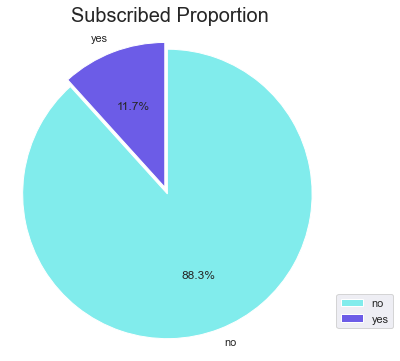

In [9]:
y_distribute = train_raw.groupby('subscribed').size()
colors = ['#81ecec','#6c5ce7']
plt.pie(y_distribute, labels = y_distribute.index, explode = (0.05, 0), autopct = '%.1f%%', colors = colors, startangle = 90, counterclock = False)
plt.axis('square')
plt.legend(loc='upper right', bbox_to_anchor=(1.2, 0.2))
plt.title('Subscribed Proportion', fontsize=20)
plt.show()

In [10]:
train = train_raw.copy()
train['subscribed'] = train_raw['subscribed'].apply(lambda x : 0 if x == 'no' else 1)
train['pdays'] = train['pdays'].replace({-1: 999})
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,apr,1,999,0,unknown,0
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,nov,3,999,0,unknown,0
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,jul,1,999,0,unknown,0
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,may,1,999,0,unknown,1
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,may,1,999,0,unknown,0


## Numerical Variables

In [11]:
def pct(category, value):
    temp = train[train[category] == value]['subscribed']
    temp_ys = sum(temp) # Yes
    temp_ns = len(temp) - temp_ys # No
    temp_r = temp_ys / len(temp) # Rate of Yes
    temp_array = np.array((temp_ys, temp_ns, temp_r))
    return(temp_array)

def normalization(arr):
    arr_min = arr.min()
    arr_max = arr.max()
    for i in range(len(arr)):
        arr[i] = (arr[i] - arr_min) / (arr_max - arr_min)
    return arr

def catExplore(category, use_pct = False):
    cat_col = train[category].sort_values().unique()
    data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])
    for value in cat_col:
        temp = [category, value]
        temp_array = pct(category, value)
        temp.append(temp_array[0])
        temp.append(temp_array[1])
        temp.append(temp_array[2])
        temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
        data_info = data_info.append(temp, ignore_index = True)
      
    fig, axes = plt.subplots(1, 3, figsize=(25, 5))
    # Box Plot
    ax = fig.axes[0]         
    sns.boxplot(train[category], ax=ax)
    ax.set_title('Box')
    ax.set_xlabel('')
    ax.set_ylabel('')

    # Reg Plot
    ax = fig.axes[1]         
    sns.regplot(train[category], train['subscribed'], ci=None, logistic=True, y_jitter=0.05, scatter_kws={'s': 25, 'alpha':.5}, ax=ax)
    ax.set_title('Reg')
    ax.set_xlabel('')
    ax.set_ylabel('')

    # Bar + PCT
    ax = fig.axes[2] 
    if use_pct:
        data_col = data_info['value'].unique().astype(int)
        data_info['total'] = data_info['yes'] + data_info['no']
        data_info['total_scaled'] = normalization(data_info['total'])
        data_info['yes_scaled'] = data_info['total_scaled'] * data_info['pct']
        data_info['no_scaled'] = data_info['total_scaled'] - data_info['yes_scaled']
        ax.bar(range(data_col[0], len(data_col) + data_col[0]), height = data_info['no_scaled'], label = 'no')
        ax.bar(range(data_col[0], len(data_col) + data_col[0]), height = data_info['yes_scaled'], bottom = data_info['no_scaled'], label = 'yes')
        sns.lineplot(data_info['value'], data_info['pct'], color = 'green', label = 'positive rate')
        ax.set_title('Bar + PCT')
        ax.set_xlabel('')
        ax.set_ylabel('')
    else:
        fig.delaxes(ax)

    plt.show()

def monthFormat(x):
    month_dict = {'apr':4, 'nov':11, 'jul':7, 'may':5, 'jun':6, 'aug':8, 'feb':2, 'jan':1, 'sep':9,
       'oct':10, 'mar':3, 'dec':12}
    if x in month_dict.keys():
        return month_dict[x]
    return x

def dateFormat(arr):
    date_temp = datetime.datetime(2021, arr['month'], arr['day'])
    return date_temp    

def getOutlier(cat):
    # IQR = Q3 - Q1
    # LB: Q1 - 1.5 * IQR 
    # UB: Q3 + 1.5 * IQR
    Q1 = train[cat].quantile(q = 0.25)
    Q3 = train[cat].quantile(q = 0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outlier = train[(train[cat] < lower_bound) | (train[cat] > upper_bound)][cat]
    print("{} outlier: {:.2f}%".format(cat, outlier.count() / train[cat].count() * 100))
    
def removeOutlier(cat):
    Q1 = train[cat].quantile(q = 0.25)
    Q3 = train[cat].quantile(q = 0.75)
    IQR = Q3 - Q1
    lower_bound = Q1 - 1.5 * IQR
    upper_bound = Q3 + 1.5 * IQR
    outlier = train[(train[cat] < lower_bound) | (train[cat] > upper_bound)][cat]
    print("{} outliers are removed.".format(outlier.count()))
    return train[(train[cat] >= lower_bound) & (train[cat] <= upper_bound)]

In [12]:
train['month'] = train['month'].apply(monthFormat)
train['date'] = train.apply(dateFormat, axis=1)
start_date = train.sort_values('date').iloc[0, :]['date']
train['date_diff'] = train['date'] - start_date
train['date_diff'] = train['date_diff'].astype('str').apply(lambda x:x[:-5]).astype('int32')
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed,date,date_diff
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,4,1,999,0,unknown,0,2021-04-20,104
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,11,3,999,0,unknown,0,2021-11-20,318
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,7,1,999,0,unknown,0,2021-07-17,192
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,5,1,999,0,unknown,1,2021-05-08,122
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,5,1,999,0,unknown,0,2021-05-07,121


  0%|                                                                                          | 0/542 [00:00<…


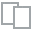
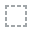
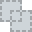
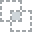
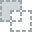
...
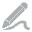
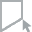
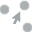
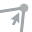
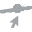

In [13]:
num_var = ['age', 'balance', 'campaign', 'pdays', 'previous', 'day', 'month', 'date_diff']
plot(train[num_var])

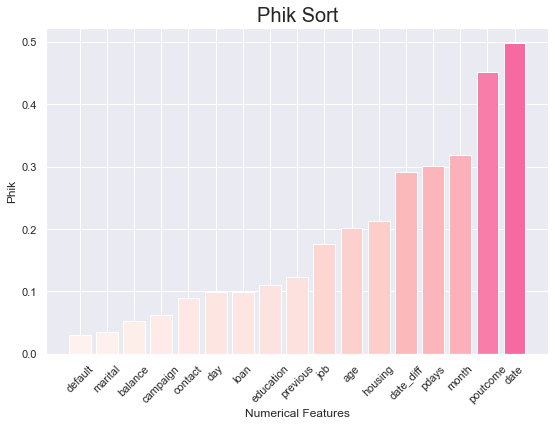

In [14]:
phik_result = train.phik_matrix(interval_cols=num_var)['subscribed'].drop('subscribed').sort_values()
colors = plt.get_cmap('RdPu')(phik_result)
plt.bar(phik_result.index, phik_result, color=colors)
plt.xticks(rotation=45)
plt.title('Phik Sort', fontsize=20)
plt.ylabel('Phik')
plt.xlabel('Numerical Features')
plt.show()

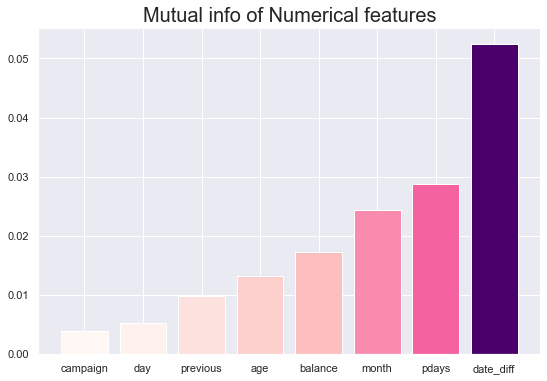

In [15]:
mutual_info = mutual_info_classif(train[num_var], train['subscribed'], random_state=42)
mutual_info = pd.Series(data=mutual_info, index=num_var).sort_values()
colors = plt.get_cmap('RdPu')((mutual_info - mutual_info.min())/(mutual_info.max() - mutual_info.min()))
plt.bar(mutual_info.index, mutual_info, color=colors)
plt.title('Mutual info of Numerical features', fontsize=20)
# plt.xticks(range(len(mutual_info)), cat_var)
plt.show()

### Age

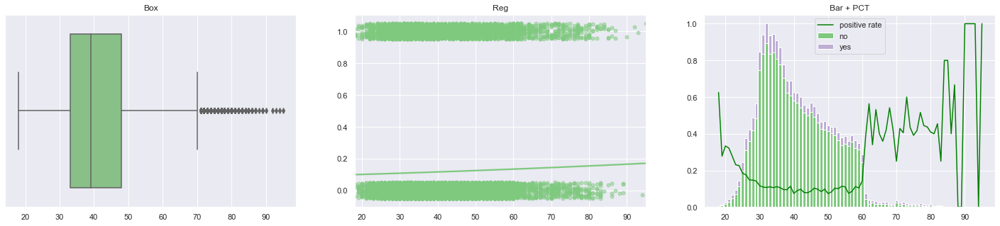

In [16]:
category = 'age'
catExplore(category, use_pct = True)

In [17]:
getOutlier(category)

age outlier: 1.09%


  0%|                                                                                          | 0/107 [00:00<…


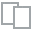
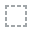
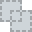
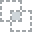
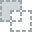
...
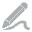
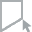
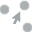
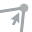
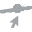

In [18]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['age']  = yj.fit_transform(train[['age']])
plot(train_temp, 'age')

### Balance

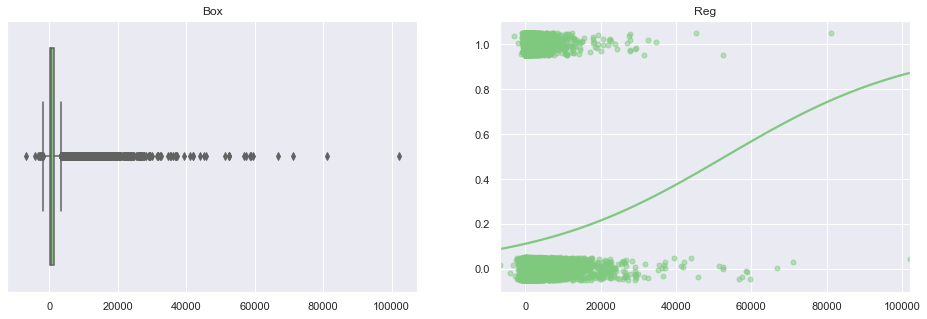

In [19]:
category = 'balance'
catExplore(category)

In [20]:
getOutlier(category)

balance outlier: 10.51%


In [21]:
# train = removeOutlier(category)
# train = train[train['balance'] < 80000]

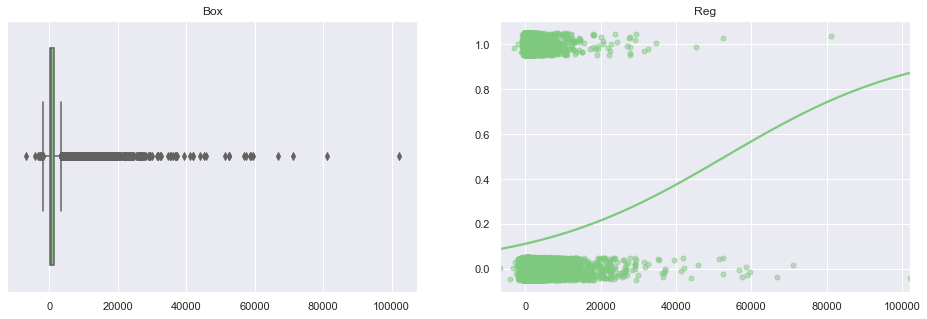

In [22]:
catExplore(category)

  0%|                                                                                          | 0/107 [00:00<…


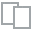
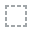
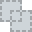
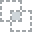
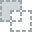
...
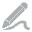
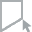
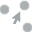
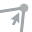
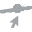

In [23]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['balance']  = yj.fit_transform(train[['balance']])
plot(train_temp, 'balance')

### Campaign

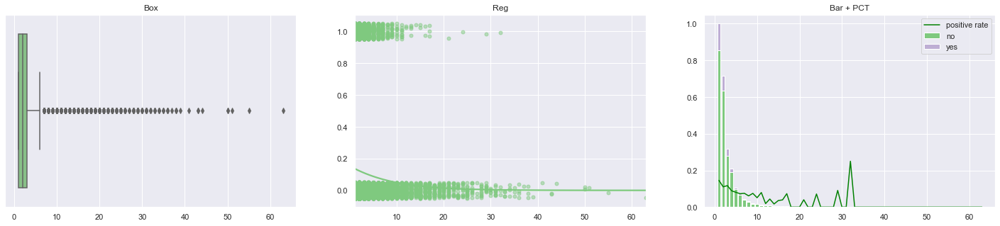

In [24]:
category = 'campaign'
catExplore(category, use_pct = True)

In [25]:
getOutlier(category)

campaign outlier: 6.91%


  0%|                                                                                          | 0/107 [00:00<…


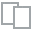
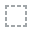
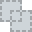
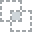
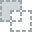
...
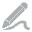
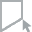
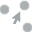
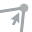
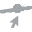

In [26]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['campaign']  = yj.fit_transform(train[['campaign']])
plot(train_temp, 'campaign')

### Pdays

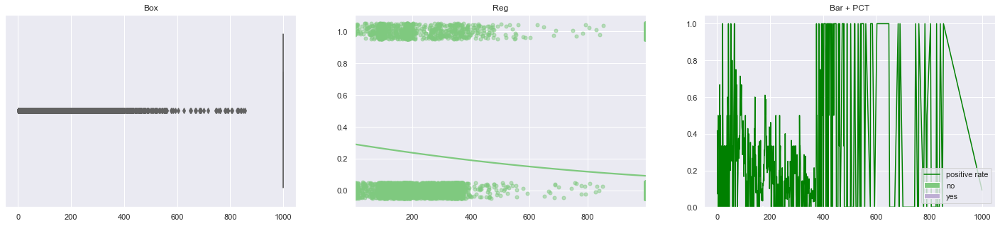

In [27]:
category = 'pdays'
catExplore(category, use_pct = True)

In [28]:
getOutlier(category)

pdays outlier: 18.21%


### Previous

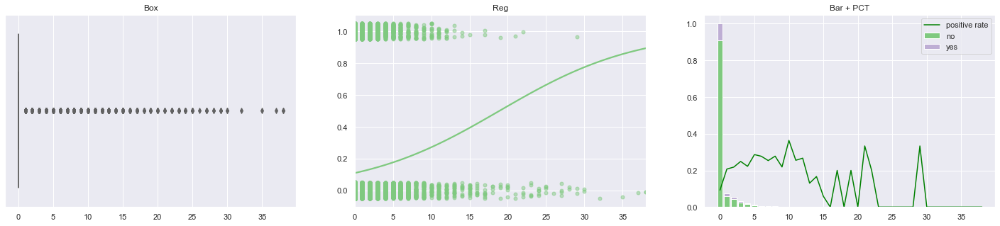

In [29]:
category = 'previous'
catExplore(category, use_pct = True)

In [30]:
getOutlier(category)

previous outlier: 18.21%


### Date

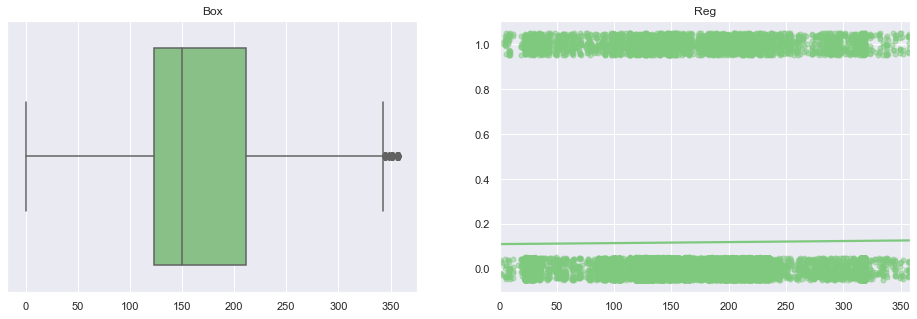

In [31]:
category = 'date_diff'
catExplore(category)

  0%|                                                                                          | 0/107 [00:00<…


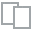
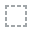
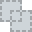
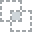
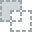
...
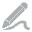
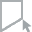
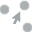
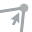
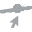

In [32]:
yj = PowerTransformer(method='yeo-johnson')
train_temp = train.copy()
train_temp['date_diff']  = yj.fit_transform(train[['date_diff']])
plot(train_temp, 'date_diff')

In [33]:
date_y_cross = pd.crosstab(train['subscribed'], train['month'])
date_y_cross_rate =  date_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index(drop=True)
date_y_cross_rate

subscribed,0,1
0,89.142237,10.857763
1,82.830626,17.169374
2,48.902821,51.097179
3,80.732984,19.267016
4,93.135935,6.864065
5,90.095569,9.904431
6,90.917069,9.082931
7,88.727898,11.272102
8,53.804348,46.195652
9,55.627706,44.372294


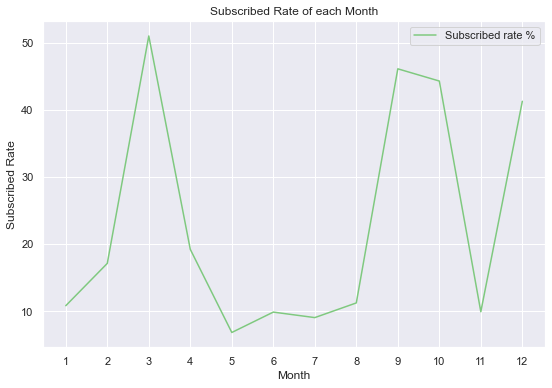

In [34]:
plt.plot(date_y_cross_rate.index, date_y_cross_rate[1], label='Subscribed rate %')
plt.xticks(date_y_cross_rate.index, date_y_cross_rate.index + 1)
plt.xlabel('Month')
plt.ylabel('Subscribed Rate')
plt.title('Subscribed Rate of each Month')
plt.legend()
plt.show()

### -- Short Summary

In [35]:
num_list = ['age', 'balance', 'month', 'day', 'pdays', 'previous', 'campaign'] # delete campaign, date_diff, pdays, days
num_count = len(num_list)
rows = int(np.ceil(num_count/3))

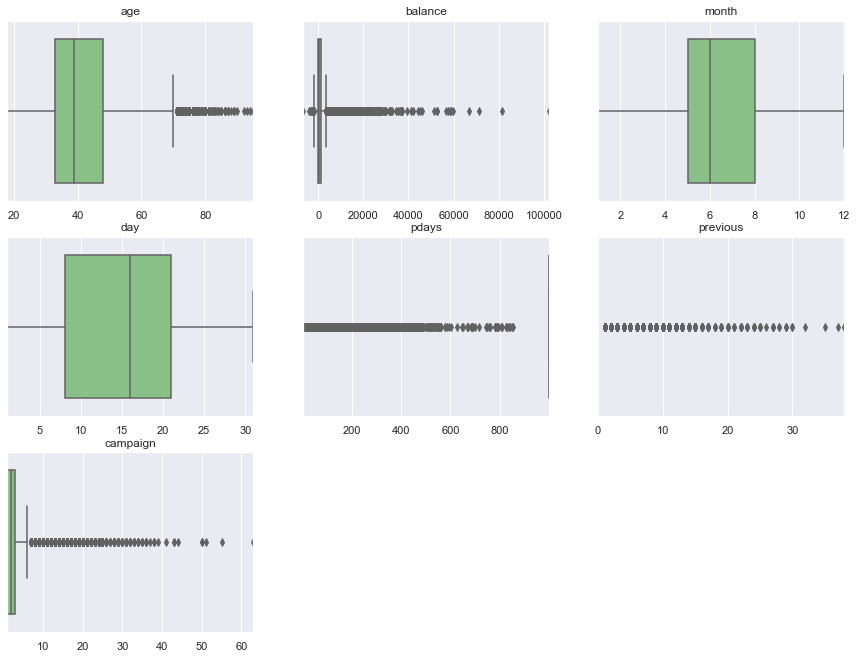

In [36]:
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < num_count:
        sns.boxplot(train[num_list[i]], ax=ax)
        ax.set_title(num_list[i])
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_xlim(train[num_list[i]].min(),train[num_list[i]].max())
    else:
        fig.delaxes(ax)
plt.show()

In [37]:
num_scaled = preprocessing.scale(train[num_list])

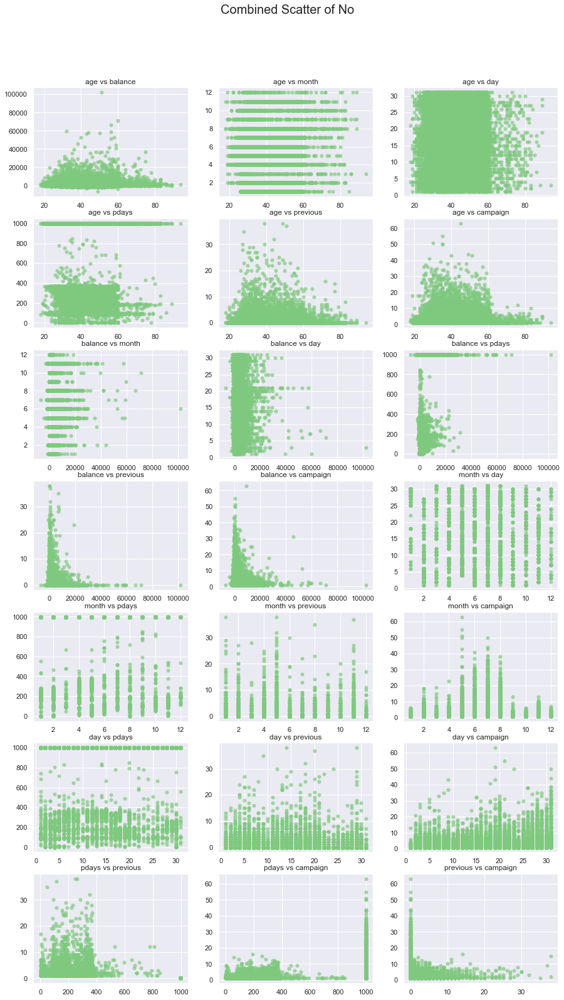

In [38]:
iter_comb = itertools.combinations(num_list, 2)
iter_list = []
for item in iter_comb:
    iter_list.append(item)

count = len(iter_list)
rows = int(np.ceil(count / 3))
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
sns.set_palette('Accent_r')
for i, ax in enumerate(fig.axes):
    if i < count:
        sns.scatterplot(x=iter_list[i][0], y=iter_list[i][1], data=train[train['subscribed'] == 0], ax=ax, alpha=0.7, linewidth=0)
        ax.set_title(iter_list[i][0] + ' vs ' + iter_list[i][1])
        ax.set_xlabel('')
        ax.set_ylabel('')
    else:
        fig.delaxes(ax)
plt.suptitle("Combined Scatter of No", fontsize=20, y=0.95)
plt.show()

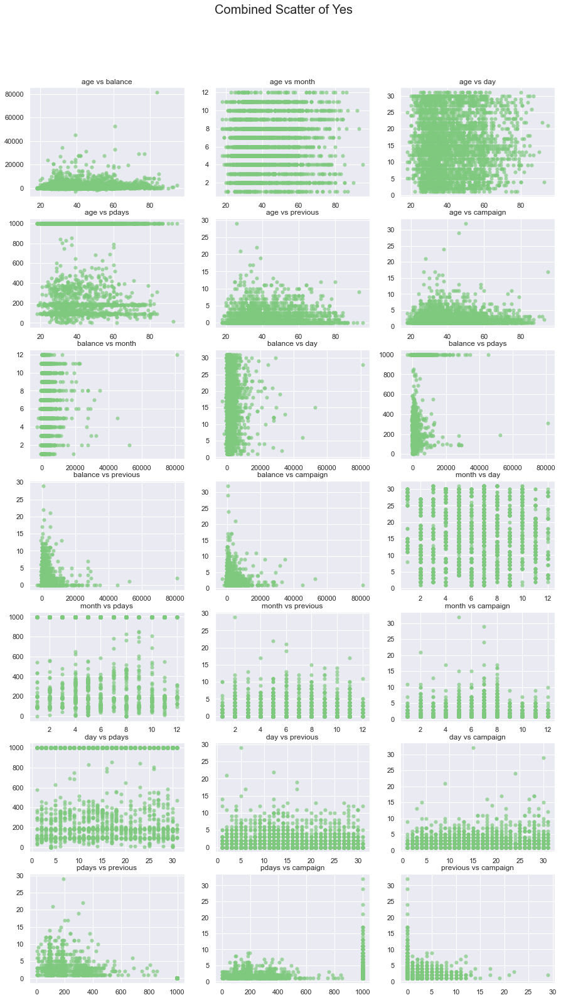

In [39]:
iter_comb = itertools.combinations(num_list, 2)
iter_list = []
for item in iter_comb:
    iter_list.append(item)

count = len(iter_list)
rows = int(np.ceil(count / 3))
sns.set_palette('Accent')
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < count:
        sns.scatterplot(x=iter_list[i][0], y=iter_list[i][1], data=train[train['subscribed'] == 1], ax=ax, alpha=0.7, linewidth=0)
        ax.set_title(iter_list[i][0] + ' vs ' + iter_list[i][1])
        ax.set_xlabel('')
        ax.set_ylabel('')
    else:
        fig.delaxes(ax)
plt.suptitle("Combined Scatter of Yes", fontsize=20, y=0.95)
plt.show()

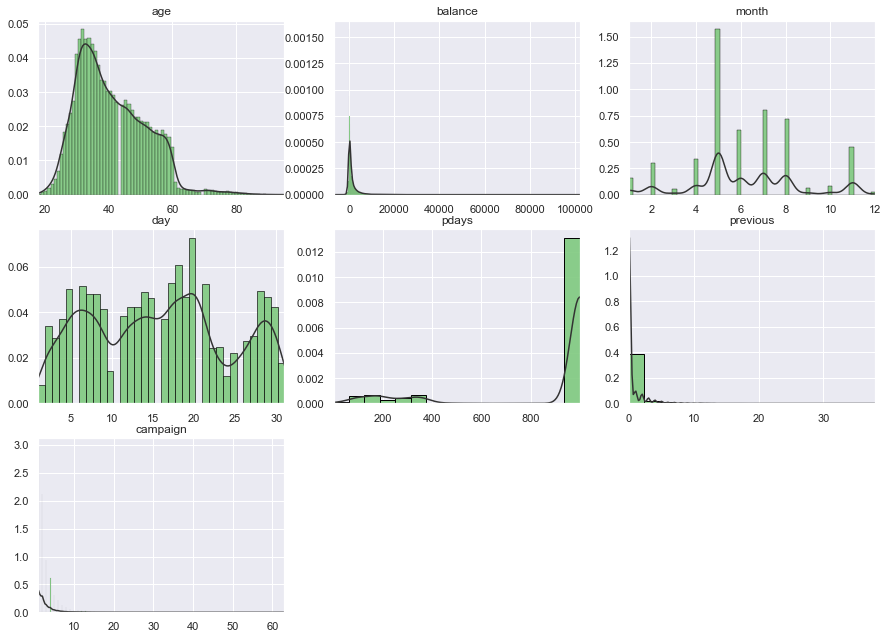

In [40]:
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < num_count:
        sns.histplot(train[num_list[i]], ax=ax, stat='density', kde=False, alpha=0.9, edgecolor='black')
        sns.kdeplot(train[num_list[i]], ax=ax, alpha=0.6, color='#333333')
        ax.set_title(num_list[i])
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_xlim(train[num_list[i]].min(),train[num_list[i]].max())
    else:
        fig.delaxes(ax)
plt.show()

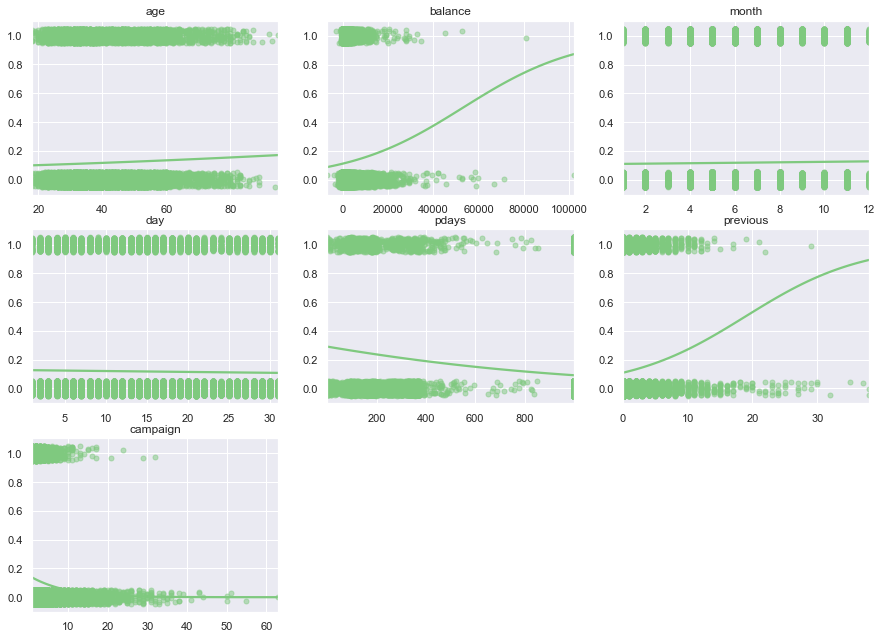

In [41]:
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
for i, ax in enumerate(fig.axes):
    if i < num_count:          
        sns.regplot(train[num_list[i]], train['subscribed'], ci=None, logistic=True, y_jitter=0.05, scatter_kws={'s': 25, 'alpha':.5}, ax=ax)
        ax.set_title(num_list[i])
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_xlim(train[num_list[i]].min(),train[num_list[i]].max())
    else:
        fig.delaxes(ax)

plt.show()

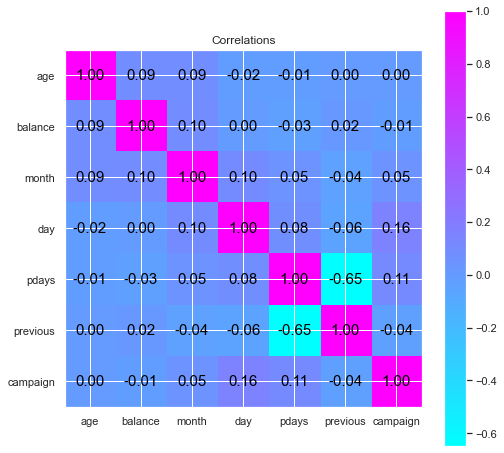

In [42]:
# Get the correlations
corr = train[num_list].corr()
n_var = len(corr)
plt.figure(figsize=(8, 8))
# Plot the heatmap
plt.imshow(corr, cmap = 'cool')
plt.xticks(range(n_var), corr.columns)
plt.yticks(range(n_var), corr.columns)

for i in range(n_var):
    for j in range(n_var):
        plt.text(i, j, '{:.2f}'.format(corr.iloc[i, j]), ha="center", va="center", color="k", fontsize = 15)

plt.colorbar()
plt.title('Correlations')
plt.show()

## Catergorical Variables

In [43]:
cat_var = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'poutcome']
cat_count = []
for column in cat_var:
    cat_count.append({'column':column, 'cat_count':len(train[column].unique())})
    
pd.DataFrame(cat_count)

,column,cat_count
0,job,12
1,marital,3
2,education,4
3,default,2
4,housing,2
5,loan,2
6,contact,3
7,poutcome,4


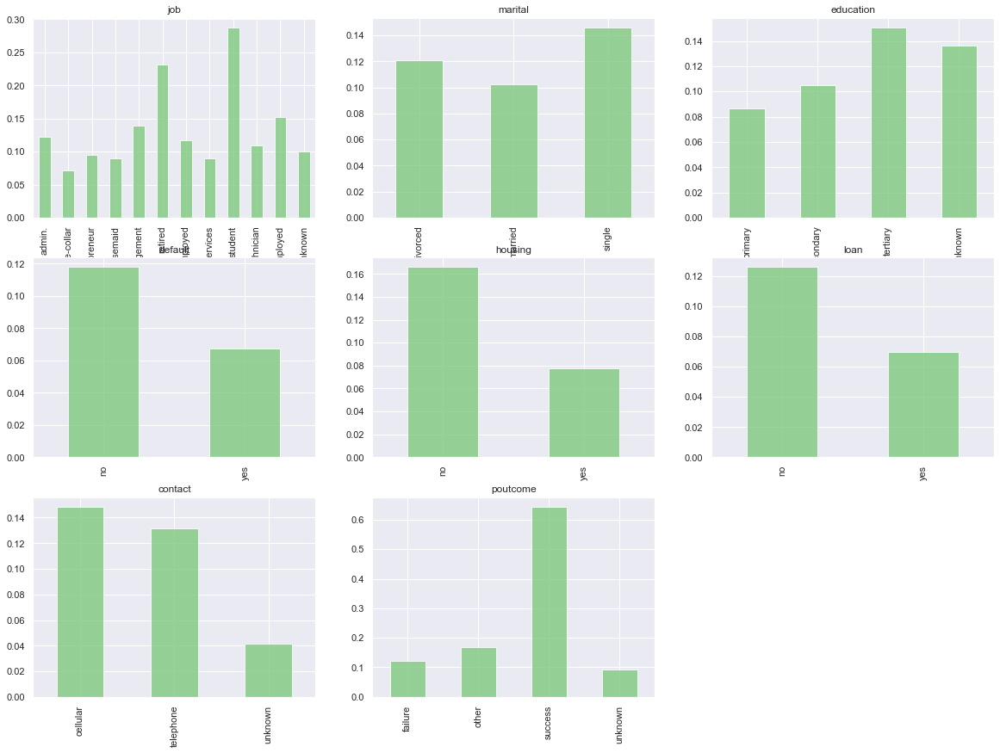

In [44]:
fig, axes = plt.subplots(rows, 3, figsize=(20, rows*(20/4)))
for i, ax in enumerate(fig.axes):
    if i < len(cat_var):
        table = pd.crosstab(train['subscribed'], train[cat_var[i]])
        table = (table/table.sum()).iloc[1,:]
        (table.T).sort_index().plot(kind='bar', alpha=0.8, ax=ax)

        ax.set_title(cat_var[i])
        ax.set_ylabel('')
        ax.set_xlabel('')
    else:
        fig.delaxes(ax)

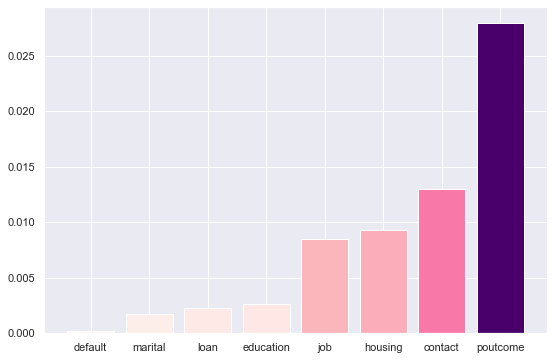

In [45]:
encoder = CatBoostEncoder().fit(train[cat_var], train['subscribed'])
mutual_info = mutual_info_classif(encoder.transform(train[cat_var]), train['subscribed'], random_state=42, discrete_features=True)
mutual_info = pd.Series(data=mutual_info, index=cat_var).sort_values()
colors = plt.get_cmap('RdPu')((mutual_info - mutual_info.min())/(mutual_info.max() - mutual_info.min()))
plt.bar(mutual_info.index, mutual_info, color=colors)
# plt.xticks(range(len(mutual_info)), cat_var)
plt.show()

In [46]:
def plotYesNo(cat, text=False):
    cat_y_cross = pd.crosstab(train['subscribed'], train[cat])
    cat_y_cross_rate = cat_y_cross.apply(lambda x : x / x.sum() * 100).reset_index(drop=True)
    plt.bar(cat_y_cross_rate.columns, cat_y_cross_rate.iloc[1, :], width=0.4)
    plt.xticks(rotation = -45)
    plt.xlabel(cat)
    plt.ylabel('Subscribed Rate')
    plt.title('Subscribed Rate of each ' + cat)
    plt.show()

### Job

In [47]:
category = 'job'
job = train[category].sort_values().unique()
data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])

for value in job:
    temp = [category, value]
    temp_array = pct(category, value)
    temp.append(temp_array[0])
    temp.append(temp_array[1])
    temp.append(temp_array[2])
    temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
    data_info = data_info.append(temp, ignore_index = True)
    
data_info.sort_values(by='pct', inplace=True)
data_info

,category,value,yes,no,pct
1,job,blue-collar,451.0,5891.0,0.071113
7,job,services,242.0,2460.0,0.089563
3,job,housemaid,73.0,738.0,0.090012
2,job,entrepreneur,91.0,862.0,0.095488
11,job,unknown,19.0,170.0,0.100529
9,job,technician,538.0,4415.0,0.108621
6,job,self-employed,119.0,894.0,0.117473
0,job,admin.,413.0,2979.0,0.121757
4,job,management,846.0,5258.0,0.138598
10,job,unemployed,127.0,709.0,0.151914


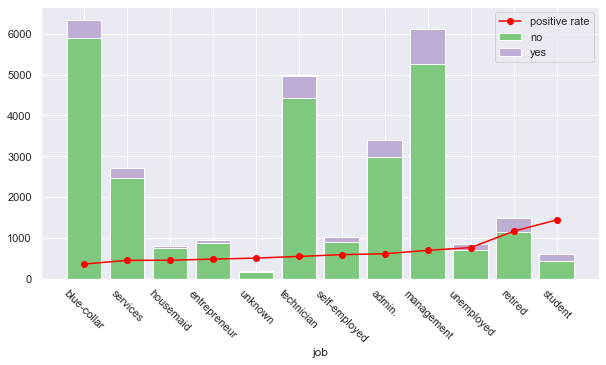

In [48]:
plt.figure(figsize = (10,5))
plt.bar(range(len(job)),height = data_info['no'], label = 'no')
plt.bar(range(len(job)),height = data_info['yes'], bottom = data_info['no'], label = 'yes')
plt.plot(data_info['value'],data_info['pct']*5000,'o-',color = 'r', label = 'positive rate')
plt.xlabel('job')
plt.xticks(rotation = -45)
plt.legend()
plt.show()

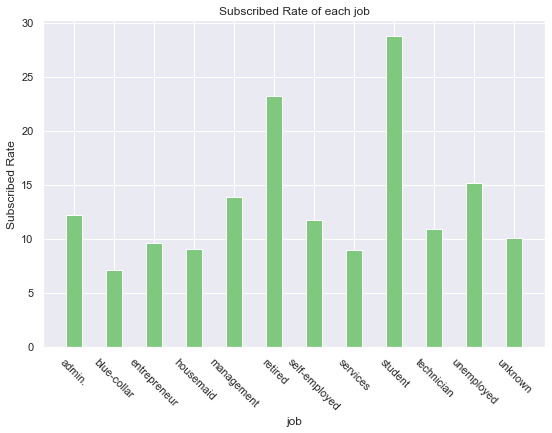

In [49]:
plotYesNo(category)

### Marital

In [50]:
category  = 'marital'
marital = train[category].sort_values().unique()
data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])

for value in marital:
    temp = [category, value]
    temp_array = pct(category, value)
    temp.append(temp_array[0])
    temp.append(temp_array[1])
    temp.append(temp_array[2])
    temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
    data_info = data_info.append(temp, ignore_index = True)
    
data_info.sort_values(by='pct', inplace=True)
data_info

,category,value,yes,no,pct
1,marital,married,1800.0,15774.0,0.102424
0,marital,divorced,413.0,3006.0,0.120796
2,marital,single,1225.0,7169.0,0.145938


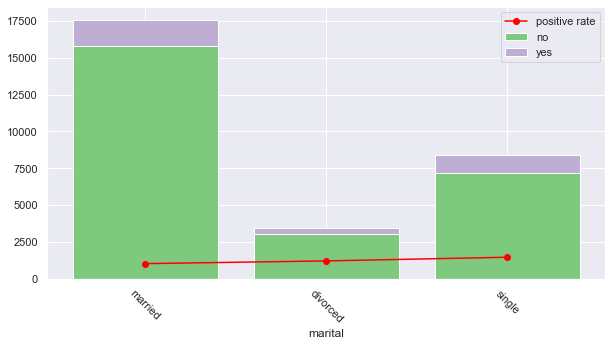

In [51]:
plt.figure(figsize = (10,5))
plt.bar(range(len(marital)),height = data_info['no'], label = 'no')
plt.bar(range(len(marital)),height = data_info['yes'], bottom = data_info['no'], label = 'yes')
plt.plot(data_info['value'],data_info['pct']*10000,'o-',color = 'r', label = 'positive rate')
plt.xlabel(category)
plt.xticks(rotation = -45)
plt.legend()
plt.show()

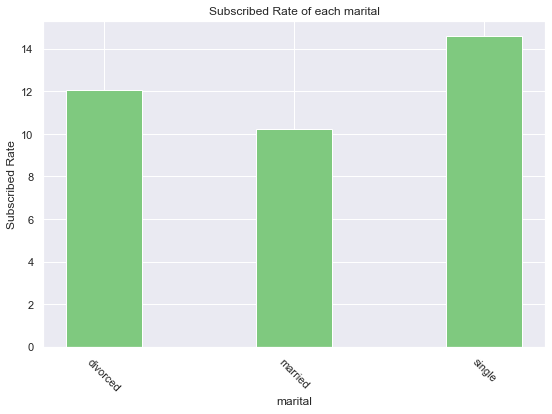

In [52]:
plotYesNo(category)

### Education

In [53]:
category = 'education'
education = train[category].sort_values().unique()
data_info = pd.DataFrame(columns = ['category', 'value', 'yes', 'no', 'pct'])

for value in education:
    temp = [category, value]
    temp_array = pct(category, value)
    temp.append(temp_array[0])
    temp.append(temp_array[1])
    temp.append(temp_array[2])
    temp = pd.Series(temp, index=['category', 'value', 'yes', 'no', 'pct'])
    data_info = data_info.append(temp, ignore_index = True)
    
data_info

,category,value,yes,no,pct
0,education,primary,387.0,4069.0,0.086849
1,education,secondary,1588.0,13515.0,0.105145
2,education,tertiary,1301.0,7338.0,0.150596
3,education,unknown,162.0,1027.0,0.136249


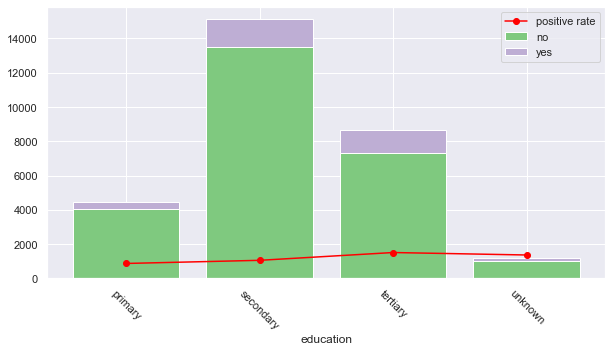

In [54]:
plt.figure(figsize = (10,5))
plt.bar(range(len(education)),height = data_info['no'], label = 'no')
plt.bar(range(len(education)),height = data_info['yes'], bottom = data_info['no'], label = 'yes')
plt.plot(data_info['value'],data_info['pct']*10000,'o-',color = 'r', label = 'positive rate')
plt.xlabel('education')
plt.xticks(rotation = -45)
plt.legend()
plt.show()

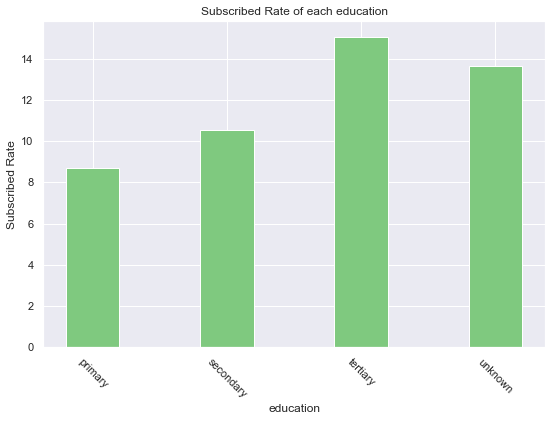

In [55]:
plotYesNo(category)

### Default

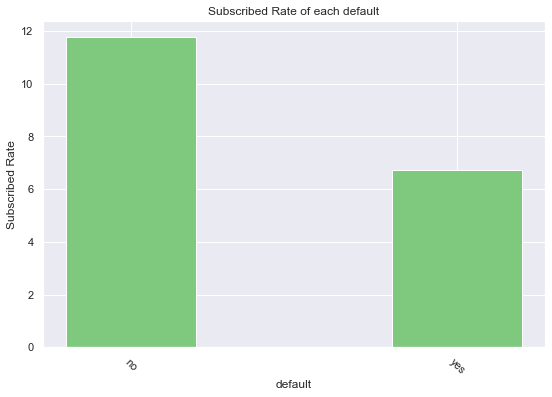

In [56]:
category = 'default'
plotYesNo(category, text=True)

### Housing

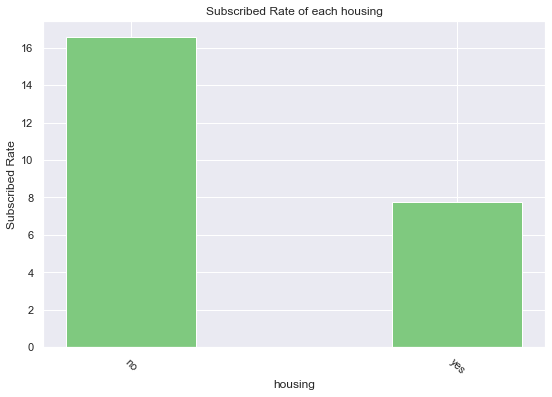

In [57]:
category = 'housing'
plotYesNo(category)

### Loan

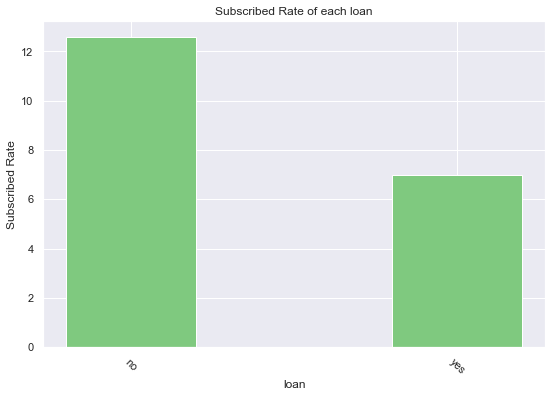

In [58]:
category = 'loan'
plotYesNo(category)

### Contact

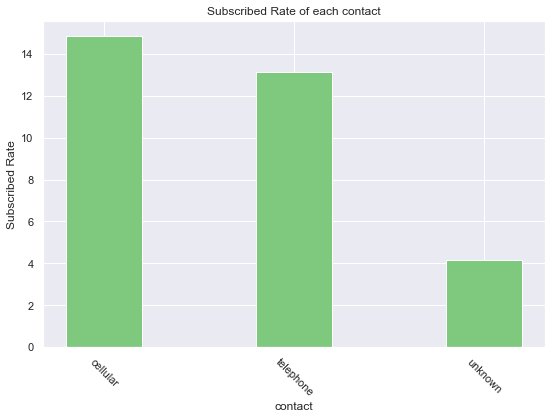

In [59]:
category = 'contact'
plotYesNo(category)

### Poutcome

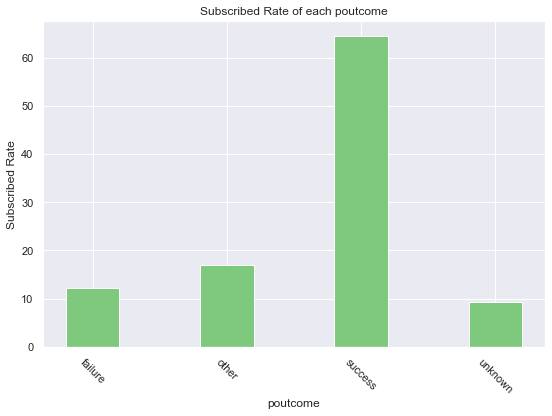

In [60]:
category = 'poutcome'
plotYesNo(category)

### -- Short Summary

In [61]:
cat_list = ['job', 'education', 'default', 'housing', 'loan', 'marital', 'contact', 'poutcome']
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,subscribed,date,date_diff
0,29,admin.,married,secondary,no,1489,yes,no,cellular,20,4,1,999,0,unknown,0,2021-04-20,104
1,33,admin.,single,tertiary,no,3379,no,no,cellular,20,11,3,999,0,unknown,0,2021-11-20,318
2,30,management,married,tertiary,no,3134,yes,no,cellular,17,7,1,999,0,unknown,0,2021-07-17,192
3,33,admin.,divorced,secondary,no,294,yes,no,cellular,8,5,1,999,0,unknown,1,2021-05-08,122
4,42,technician,married,tertiary,no,644,yes,no,unknown,7,5,1,999,0,unknown,0,2021-05-07,121


## Deeper Exploring

### Pdays Group

In [62]:
def setPdaysGroup(data):
    pdays = data['pdays']
    bins = [0, 100, 999]
    pdays_group = pd.cut(pdays, bins)
    return pdays_group

train['pdays_group'] = setPdaysGroup(train)
pdays_y_cross = pd.crosstab(train['subscribed'], train['pdays_group'])
pdays_y_cross_rate = pdays_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
pdays_y_cross_rate

subscribed,pdays_group,0,1
0,"(0, 100]",57.203390,42.796610
1,"(100, 999]",89.333052,10.666948


### Age Group

In [63]:
def setAgeGroup(data):
    ages = data['age']
    bins = [0, 30, 40, 50, 60, 100]
    age_group = pd.cut(ages, bins)
    return age_group

train['age_group'] = setAgeGroup(train)
age_y_cross = pd.crosstab(train['subscribed'], train['age_group'])
age_y_cross_rate = age_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
age_y_cross_rate

subscribed,age_group,0,1
0,"(0, 30]",84.181778,15.818222
1,"(30, 40]",89.614682,10.385318
2,"(40, 50]",91.084370,8.915630
3,"(50, 60]",89.823687,10.176313
4,"(60, 100]",56.905371,43.094629


In [64]:
age_pdays_cross = pd.crosstab(train['pdays_group'], train['age_group'])
age_pdays_cross_rate = age_pdays_cross.apply(lambda x : x / x.sum() * 100).transpose().reset_index(drop=True)
age_pdays_cross_rate

pdays_group,"(0, 100]","(100, 999]"
0,4.063797,95.936203
1,2.826824,97.173176
2,2.133187,97.866813
3,3.257953,96.742047
4,13.682864,86.317136


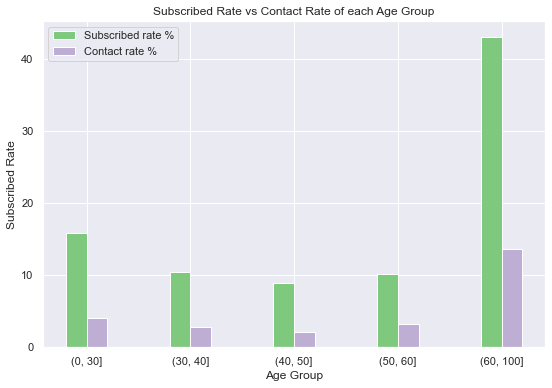

In [65]:
plt.bar(age_y_cross_rate.index - 0.1, age_y_cross_rate[1], width=0.2, label='Subscribed rate %')
plt.bar(age_pdays_cross_rate.index + 0.1, age_pdays_cross_rate.iloc[:, 0], width=0.2, label='Contact rate %')
plt.xticks(age_y_cross_rate.index, age_y_cross_rate['age_group'].astype(str))
plt.xlabel('Age Group')
plt.ylabel('Subscribed Rate')
plt.title('Subscribed Rate vs Contact Rate of each Age Group')
plt.legend()
plt.show()

### Balance Group

In [66]:
def setBalanceGroup(data):
    balance = data['balance']
    bins = [-3000, 0, 1000, 2000, 3000, 4000, 10000]
    balance_group = pd.cut(balance, bins)
    return balance_group

train['balance_group'] = setBalanceGroup(train)
balance_y_cross = pd.crosstab(train['subscribed'], train['balance_group'])
balance_y_cross_rate = balance_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
balance_y_cross_rate

subscribed,balance_group,0,1
0,"(-3000, 0]",93.036791,6.963209
1,"(0, 1000]",88.985795,11.014205
2,"(1000, 2000]",86.375126,13.624874
3,"(2000, 3000]",83.288264,16.711736
4,"(3000, 4000]",82.905226,17.094774
5,"(4000, 10000]",84.427481,15.572519


In [67]:
balance_pdays_cross = pd.crosstab(train['pdays_group'], train['balance_group'])
balance_pdays_cross_rate = balance_pdays_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index(drop=True)
balance_pdays_cross_rate

pdays_group,"(0, 100]","(100, 999]"
0,1.642070,98.357930
1,2.926990,97.073010
2,4.246714,95.753286
3,5.083829,94.916171
4,4.074402,95.925598
5,4.427481,95.572519


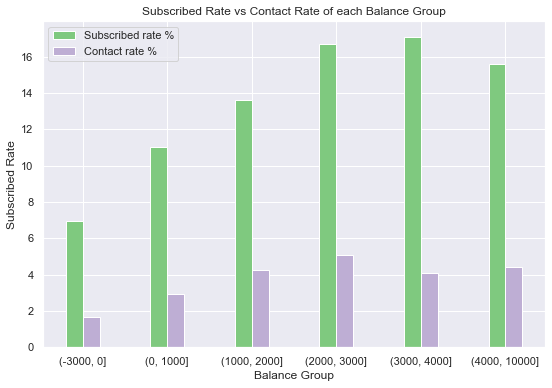

In [68]:
plt.bar(balance_y_cross_rate.index - 0.1, balance_y_cross_rate[1], width=0.2, label='Subscribed rate %')
plt.bar(balance_pdays_cross_rate.index + 0.1, balance_pdays_cross_rate.iloc[:, 0], width=0.2, label='Contact rate %')
plt.xticks(balance_y_cross_rate.index, balance_y_cross_rate['balance_group'].astype(str))
plt.xlabel('Balance Group')
plt.ylabel('Subscribed Rate')
plt.title('Subscribed Rate vs Contact Rate of each Balance Group')
plt.legend()
plt.show()

### Campaign Group

In [69]:
def setCampaignGroup(data):
    campaign = data['campaign']
    bins = [-100, 0, 20, 40, 100]
    campaign_group = pd.cut(campaign, bins)
    return campaign_group

train['campaign_group'] = setCampaignGroup(train)
campaign_y_cross = pd.crosstab(train['subscribed'], train['campaign_group'])
campaign_y_cross_rate = campaign_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
campaign_y_cross_rate

subscribed,campaign_group,0,1
0,"(0, 20]",88.245362,11.754638
1,"(20, 40]",97.560976,2.439024
2,"(40, 100]",100.000000,0.000000


### Previous Group

In [70]:
def setPreviousGroup(data):
    previous = data['previous']
    bins = [0, 5, 15, 100]
    previous_group = pd.cut(previous, bins)
    return previous_group

train['previous_group'] = setPreviousGroup(train)
previous_y_cross = pd.crosstab(train['subscribed'], train['previous_group'])
previous_y_cross_rate = previous_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
previous_y_cross_rate

subscribed,previous_group,0,1
0,"(0, 5]",77.598451,22.401549
1,"(5, 15]",74.326466,25.673534
2,"(15, 100]",91.780822,8.219178


### Month Group

In [71]:
def setMonthGroup(data):
    month = data['month']
    bins = [0, 3, 6, 9, 12]
    month_group = pd.cut(month, bins)
    return month_group

train['month_group'] = setMonthGroup(train)
month_y_cross = pd.crosstab(train['subscribed'], train['month_group'])
month_y_cross_rate = month_y_cross.apply(lambda x : x/x.sum() * 100).transpose().reset_index()
month_y_cross_rate

subscribed,month_group,0,1
0,"(0, 3]",81.140351,18.859649
1,"(3, 6]",90.741649,9.258351
2,"(6, 9]",88.408535,11.591465
3,"(9, 12]",83.661793,16.338207


# Model

## Data Transformation

In [79]:
group_var = ['age_group', 'balance_group', 'campaign_group', 'pdays_group', 'previous_group', 'month_group']
# train[group_var] = train[group_var].astype(str)
for item in group_var:
    train[item] = LabelEncoder().fit_transform(train[item])

In [80]:
num_var = ['age', 'balance', 'campaign', 'pdays', 'previous', 'day', 'month', 'date_diff']
cat_var = ['job', 'marital', 'education', 'default', 'housing', 'loan', 'contact', 'poutcome']
group_var = ['age_group', 'balance_group', 'campaign_group', 'pdays_group', 'previous_group', 'month_group']

yj = PowerTransformer(method='yeo-johnson')
train['age']  = yj.fit_transform(train[['age']])
train['balance']  = yj.fit_transform(train[['balance']])
train['date_diff']  = yj.fit_transform(train[['date_diff']])
scaler = StandardScaler().fit(train[num_var], train['subscribed'])
encoder = CatBoostEncoder().fit(train[np.append(cat_var, group_var)], train['subscribed'])

train[num_var] = scaler.transform(train[num_var])
train[np.append(cat_var, group_var)] = encoder.transform(train[np.append(cat_var, group_var)])

## Preparation

In [81]:
train.head()

,age,job,marital,education,default,balance,housing,loan,contact,day,...,poutcome,subscribed,date,date_diff,pdays_group,age_group,balance_group,campaign_group,previous_group,month_group
0,-1.236728,0.121756,0.102425,0.105145,0.117881,0.198091,0.077685,0.125992,0.148487,0.496847,...,0.092805,0,2021-04-20,-0.789413,1,0,2,0,3,1
1,-0.706859,0.121756,0.145934,0.150592,0.117881,0.814296,0.165924,0.125992,0.148487,0.496847,...,0.092805,0,2021-11-20,1.924806,1,1,4,0,3,3
2,-1.096622,0.138594,0.102425,0.150592,0.117881,0.738529,0.077685,0.125992,0.148487,0.136638,...,0.092805,0,2021-07-17,0.400324,1,0,4,0,3,2
3,-0.706859,0.121756,0.120794,0.105145,0.117881,-0.266936,0.077685,0.125992,0.148487,-0.943990,...,0.092805,1,2021-05-08,-0.533336,1,1,1,0,3,1
4,0.252024,0.108623,0.102425,0.150592,0.117881,-0.117463,0.077685,0.125992,0.041735,-1.064059,...,0.092805,0,2021-05-07,-0.547353,1,2,1,0,3,1


In [82]:
num_list = ['age', 'balance', 'month', 'day', 'pdays', 'previous', 'campaign', 'date_diff']
cat_list = ['job', 'education', 'default', 'housing', 'loan', 'marital', 'contact', 'poutcome']
group_list = ['age_group', 'balance_group', 'campaign_group', 'pdays_group', 'previous_group', 'month_group']

input_list = []
input_list.extend(num_list)
input_list.extend(cat_list)
input_list.extend(group_list)

X = train[input_list]
y = train['subscribed']
X.head()

,age,balance,month,day,pdays,previous,campaign,date_diff,job,education,...,loan,marital,contact,poutcome,age_group,balance_group,campaign_group,pdays_group,previous_group,month_group
0,-1.236728,0.198091,-0.889361,0.496847,0.465589,-0.305997,-0.568197,-0.789413,0.121756,0.105145,...,0.125992,0.102425,0.148487,0.092805,0,2,0,1,3,1
1,-0.706859,0.814296,2.024451,0.496847,0.465589,-0.305997,0.065705,1.924806,0.121756,0.150592,...,0.125992,0.145934,0.148487,0.092805,1,4,0,1,3,3
2,-1.096622,0.738529,0.359416,0.136638,0.465589,-0.305997,-0.568197,0.400324,0.138594,0.150592,...,0.125992,0.102425,0.148487,0.092805,0,4,0,1,3,2
3,-0.706859,-0.266936,-0.473102,-0.943990,0.465589,-0.305997,-0.568197,-0.533336,0.121756,0.105145,...,0.125992,0.120794,0.148487,0.092805,1,1,0,1,3,1
4,0.252024,-0.117463,-0.473102,-1.064059,0.465589,-0.305997,-0.568197,-0.547353,0.108623,0.150592,...,0.125992,0.102425,0.041735,0.092805,2,1,0,1,3,1


## Train test split

In [83]:
ss = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_full_index, test_index in ss.split(X, y):
    X_train_full, X_test = X.iloc[train_full_index], X.iloc[test_index]
    y_train_full, y_test = y.iloc[train_full_index], y.iloc[test_index]
    
ss = StratifiedShuffleSplit(n_splits=1, test_size=0.25, random_state=42)
for train_index, valid_index in ss.split(X_train_full, y_train_full):
    X_train, X_valid = X_train_full.iloc[train_index], X_train_full.iloc[valid_index]
    y_train, y_valid = y_train_full.iloc[train_index], y_train_full.iloc[valid_index]
    
# X_train_full, X_test, y_train_full, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)
# X_train, X_valid, y_train, y_valid = train_test_split(X_train, y_train, test_size=0.25, random_state=42, stratify=y_train)

## Feature Engineering

### Polynomial Exploring

In [86]:
def polyExplore(target, times=5):
    target_train = X_train[target]
    X_train_temp = pd.DataFrame()
    target_valid = X_valid[target]
    X_valid_temp = pd.DataFrame()
    columns = ['Error Rate', 'Sensitivity', 'Specificity', 'Precision', 'AUC', 'Cross-entropy', 'Cross-AUC']
    rows = range(1, times)
    results = pd.DataFrame(0.0, columns=columns, index=rows)
    def polyExploreThread(i):
        temp_train = X_train_temp.iloc[:, :i]
        temp_valid = X_valid_temp.iloc[:, :i]
        logit = LogisticRegressionCV()
        logit.fit(temp_train, y_train)
        y_prob = logit.predict_proba(temp_valid)[:, 1]
        y_pred = logit.predict(temp_valid)

        tn, fp, fn, tp = confusion_matrix(y_valid, y_pred).ravel() 

        results.iloc[i-1, 0] =  1 - accuracy_score(y_valid, y_pred)
        results.iloc[i-1, 1] =  tp / (tp + fn)
        results.iloc[i-1, 2] =  tn / (tn + fp)
        results.iloc[i-1, 3] =  precision_score(y_valid, y_pred)
        results.iloc[i-1, 4] =  roc_auc_score(y_valid, y_prob)
        results.iloc[i-1, 5] =  log_loss(y_valid, y_prob)
        results.iloc[i-1, 6] =  cross_val_score(logit, temp_train, y_train, scoring='roc_auc').mean()

    thread_list = []

    for i in range(1, times):
        X_train_temp[target+str(i)] = target_train ** i
        X_valid_temp[target+str(i)] = target_valid ** i
        
    for i in range(1, times):
        thread = threading.Thread(target=polyExploreThread, args=(i,))
        thread_list.append(thread)
        thread.start()
  
    for thread in thread_list:
        thread.join()
        
    return results

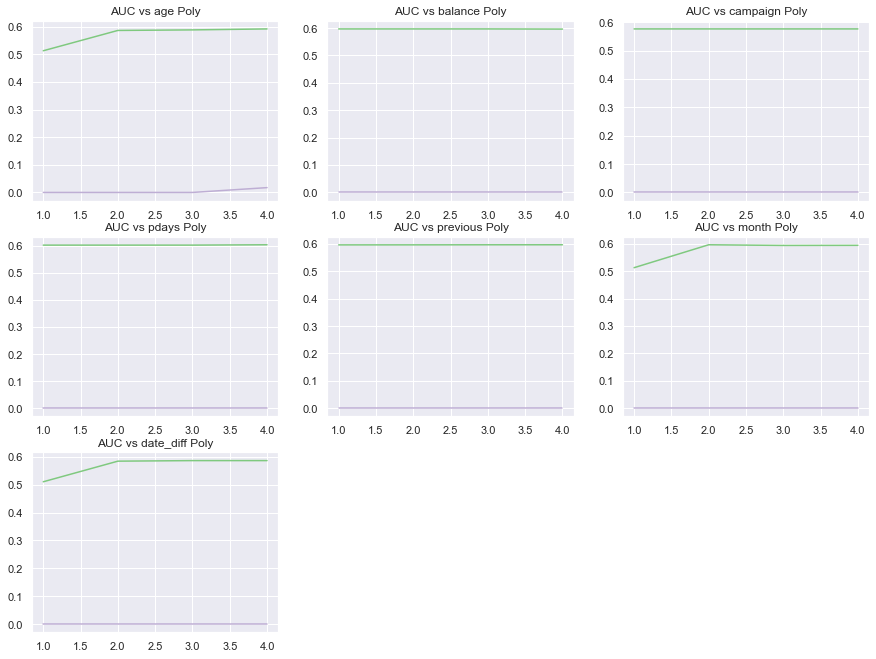

Wall time: 1min 5s


In [87]:
%%time
x_input = ['age', 'balance', 'campaign', 'pdays', 'previous', 'month', 'date_diff']
x_count = len(x_input)
rows = int(np.ceil(x_count/3))
fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)))
thread_list = []
def polyThread(i, ax):
    global x_count, x_input
    if i < x_count:
        poly = polyExplore(x_input[i])
        sns.lineplot(x=poly.index, y=poly['Cross-AUC'], ax=ax)
        sns.lineplot(x=poly.index, y=poly['Sensitivity'], ax=ax)
        ax.set_xlabel('')
        ax.set_ylabel('')
        ax.set_title('AUC vs {} Poly'.format(x_input[i]))
    else:
        fig.delaxes(ax)
for i, ax in enumerate(fig.axes):
    thread = threading.Thread(target=polyThread, args=(i, ax, ))
    thread_list.append(thread)
    thread.start()
for thread in thread_list:
    thread.join()
plt.show()

### Model Transformation

In [88]:
class ModelTrans:
    def __init__(self, age=1, balance=1, campaign=1, pdays=1, previous=1, month=1, date_diff=1): 
        self.age = age
        self.balance = balance
        self.campaign = campaign
        self.pdays = pdays
        self.previous = previous
        self.date_diff = date_diff
        self.month = month

    def xTrans(self, x):
        for i in range(2, self.age + 1):
            x['age'+str(i)] = x['age'] ** i
        for i in range(2, self.balance + 1):
            x['balance'+str(i)] = x['balance'] ** i
        for i in range(2, self.campaign + 1):
            x['campaign'+str(i)] = x['campaign'] ** i
        for i in range(2, self.pdays + 1):
            x['pdays'+str(i)] = x['pdays'] ** i
        for i in range(2, self.previous + 1):
            x['previous'+str(i)] = x['previous'] ** i
        for i in range(2, self.month + 1):
            x['month'+str(i)] = x['month'] ** i
        for i in range(2, self.date_diff + 1):
            x['date_diff'+str(i)] = x['date_diff'] ** i
        return x

In [89]:
modelTrans = ModelTrans(age=2, month=2, date_diff=2)
X_train = modelTrans.xTrans(X_train)
X_valid = modelTrans.xTrans(X_valid)
X_train_full = modelTrans.xTrans(X_train_full)
X_test = modelTrans.xTrans(X_test)
X = modelTrans.xTrans(X)

## Model Fitting

In [90]:
def hypmExplore(model, params):
    count = len(params)
    rows = int(np.ceil(count / 3))
    fig, axes = plt.subplots(rows, 3, figsize=(15, rows*(15/4)), constrained_layout=True)

    for i, ax in enumerate(fig.axes):
        if i < count:
            param_key = list(params.keys())[i]
            param_val = params[param_key]
            train_AUC = []
            valid_AUC = []
            indexs = []

            for j in param_val:
                param_input = {param_key: j}
                model.set_params(**param_input)
                model.fit(X_train, y_train)
                y_prob = model.predict_proba(X_train)[:, 1]
                train_AUC.append(roc_auc_score(y_train, y_prob))
                valid_AUC.append(np.mean(cross_validate(model, X_valid, y_valid, cv=5)['test_score']))
                indexs.append(j)

            ax.plot(indexs, train_AUC, label="Training AUC", marker='o',)
            ax.plot(indexs, valid_AUC, label="5 fold CV Validation AUC", marker='o')
            ax.set_xlabel(param_key, fontsize=18)
            ax.set_ylabel('AUC', fontsize=18)
            ax.legend()

        else:
            fig.delaxes(ax)

    plt.tight_layout()
    plt.show()

### Logistic Regression CV

In [91]:
logit = LogisticRegressionCV()
logit.fit(X_train, y_train)

LogisticRegressionCV()

### KNN

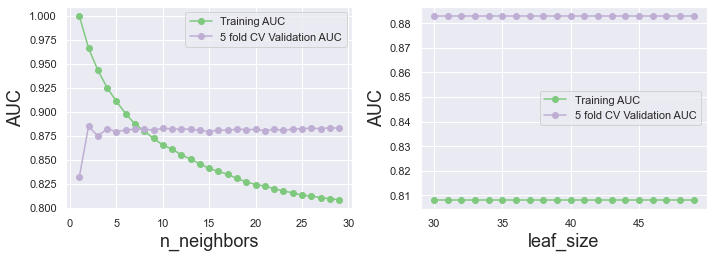

Wall time: 3min 10s


In [92]:
%%time
knn = KNeighborsClassifier()
params = {
    'n_neighbors': [1, 3, 5, 10, 15, 20, 25, 30],
    'leaf_size': [30, 40, 50]
}
hypmExplore(knn, params)

In [93]:
params = {
    'n_neighbors': [1, 2, 3, 5, 10, 15]
}
knn = KNeighborsClassifier()
grid_search = GridSearchCV(
    estimator=knn, 
    param_grid=params, 
    cv=5, 
    n_jobs=-1, 
    verbose=1, 
    scoring = "roc_auc")
grid_search.fit(X, y)

Fitting 5 folds for each of 14 candidates, totalling 70 fits


GridSearchCV(cv=5, estimator=KNeighborsClassifier(), n_jobs=-1,
             param_grid={'n_neighbors': [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12,
                                         13, 14]},
             scoring='roc_auc', verbose=1)

In [94]:
knn = grid_search.best_estimator_
knn

KNeighborsClassifier(n_neighbors=14)

In [95]:
y_prob = knn.predict_proba(X_train)[:, 1]
train_AUC = roc_auc_score(y_train, y_prob)
valid_AUC = cross_validate(knn, X_valid, y_valid, cv=5)['test_score'].mean()
# y_prob = grid_search.best_estimator_.predict_proba(X_test)[:, 1]
# test_AUC = roc_auc_score(y_test, y_prob)
print('train AUC: {}, \nvalidation AUC: {}'.format(train_AUC, valid_AUC))

train AUC: 0.849010200765168, 
validation AUC: 0.8807422202923721


### LGBoost

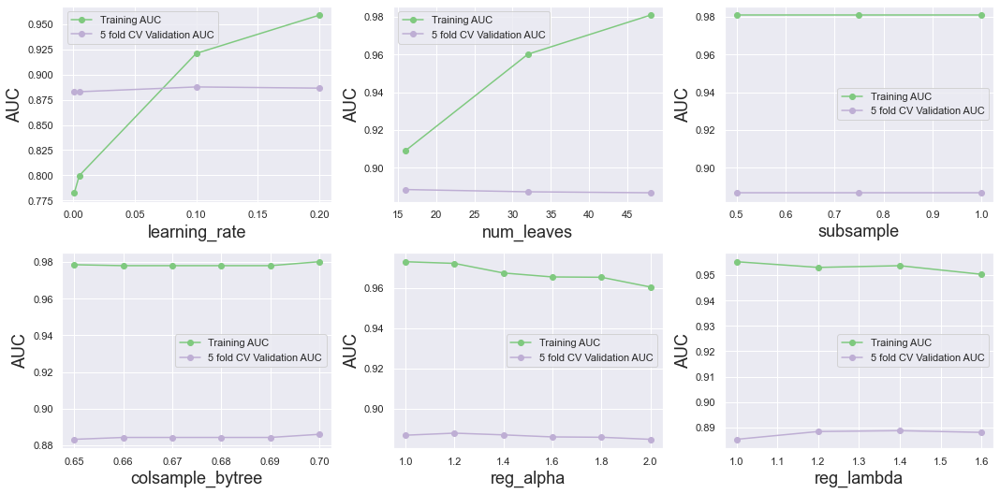

In [96]:
lgb = LGBMClassifier()
params = {
    'learning_rate': [0.001, 0.005, 0.10, 0.20],
    'num_leaves': [16, 32, 48, 64],
    'subsample' : [0.5, 0.75, 1.0],
    'colsample_bytree' : [0.65, 0.66, 0.67, 0.68, 0.69, 0.70],
    'reg_alpha' : [1, 1.2, 1.4, 1.6, 1.8, 2.0],
    'reg_lambda' : [1, 1.2, 1.4, 1.6]
}
hypmExplore(lgb, params)

In [97]:
%%time
gridParams = {
    'learning_rate': [0.005, 0.10, 0.15],
    'n_estimators': [40],
    'num_leaves': [16, 32, 64],
    'objective' : ['binary'],
    'random_state' : [42],
    'num_boost_round' : [3000],
    'colsample_bytree' : [0.65, 0.66],
    'subsample' : [0.7,0.75],
    'reg_alpha' : [1, 1.4, 1.8],
    'reg_lambda' : [1, 1.2, 1.4],
    }

lgb_estimator = LGBMClassifier(
    boosting_type = 'gbdt', 
    objective = 'binary', 
    metric  = 'auc',
    eval_metric  = 'auc',
    verbose_eval=20, 
    early_stopping_rounds=100
)

grid_search = GridSearchCV(estimator=lgb_estimator, param_grid=gridParams, scoring='roc_auc', n_jobs = -1, cv = 5)
grid_search.fit(X, y, eval_set = [(X_valid, y_valid)], verbose=True)
lgb = grid_search.best_estimator_
params = lgb.get_params()
print(params)
# Remove early_stopping_rounds
params["early_stopping_rounds"] = None
lgb.set_params(**params)
y_prob = lgb.predict_proba(X_valid)[:, 1]
print('Validation AUC:{}'.format(roc_auc_score(y_valid, y_prob)))

[LightGBM] [Warning] Unknown parameter: verbose_eval
[LightGBM] [Warning] Unknown parameter: eval_metric
[LightGBM] [Warning] early_stopping_round is set=100, early_stopping_rounds=100 will be ignored. Current value: early_stopping_round=100
[LightGBM] [Warning] num_iterations is set=3000, num_boost_round=3000 will be ignored. Current value: num_iterations=3000
[1]	valid_0's auc: 0.751423
[2]	valid_0's auc: 0.770369
[3]	valid_0's auc: 0.787287
[4]	valid_0's auc: 0.7873
[5]	valid_0's auc: 0.785161
[6]	valid_0's auc: 0.785718
[7]	valid_0's auc: 0.783552
[8]	valid_0's auc: 0.786241
[9]	valid_0's auc: 0.786377
[10]	valid_0's auc: 0.786809
[11]	valid_0's auc: 0.790246
[12]	valid_0's auc: 0.789872
[13]	valid_0's auc: 0.789221
[14]	valid_0's auc: 0.78835
[15]	valid_0's auc: 0.78889
[16]	valid_0's auc: 0.789647
[17]	valid_0's auc: 0.790843
[18]	valid_0's auc: 0.791891
[19]	valid_0's auc: 0.792175
[20]	valid_0's auc: 0.792057
[21]	valid_0's auc: 0.791759
[22]	valid_0's auc: 0.791893
[23]	valid_

[395]	valid_0's auc: 0.805361
[396]	valid_0's auc: 0.805368
[397]	valid_0's auc: 0.805378
[398]	valid_0's auc: 0.805439
[399]	valid_0's auc: 0.805453
[400]	valid_0's auc: 0.805502
[401]	valid_0's auc: 0.805523
[402]	valid_0's auc: 0.805548
[403]	valid_0's auc: 0.805587
[404]	valid_0's auc: 0.805635
[405]	valid_0's auc: 0.805628
[406]	valid_0's auc: 0.805623
[407]	valid_0's auc: 0.805656
[408]	valid_0's auc: 0.805681
[409]	valid_0's auc: 0.805707
[410]	valid_0's auc: 0.805772
[411]	valid_0's auc: 0.805797
[412]	valid_0's auc: 0.805811
[413]	valid_0's auc: 0.805828
[414]	valid_0's auc: 0.805832
[415]	valid_0's auc: 0.805849
[416]	valid_0's auc: 0.805865
[417]	valid_0's auc: 0.805881
[418]	valid_0's auc: 0.80595
[419]	valid_0's auc: 0.80595
[420]	valid_0's auc: 0.805967
[421]	valid_0's auc: 0.80598
[422]	valid_0's auc: 0.805987
[423]	valid_0's auc: 0.806047
[424]	valid_0's auc: 0.80605
[425]	valid_0's auc: 0.806084
[426]	valid_0's auc: 0.806118
[427]	valid_0's auc: 0.806136
[428]	valid_0'

[812]	valid_0's auc: 0.816586
[813]	valid_0's auc: 0.8166
[814]	valid_0's auc: 0.816614
[815]	valid_0's auc: 0.816655
[816]	valid_0's auc: 0.816678
[817]	valid_0's auc: 0.816704
[818]	valid_0's auc: 0.816736
[819]	valid_0's auc: 0.81675
[820]	valid_0's auc: 0.816793
[821]	valid_0's auc: 0.816831
[822]	valid_0's auc: 0.816847
[823]	valid_0's auc: 0.816852
[824]	valid_0's auc: 0.816911
[825]	valid_0's auc: 0.816912
[826]	valid_0's auc: 0.816938
[827]	valid_0's auc: 0.81694
[828]	valid_0's auc: 0.816969
[829]	valid_0's auc: 0.816982
[830]	valid_0's auc: 0.817029
[831]	valid_0's auc: 0.817076
[832]	valid_0's auc: 0.817119
[833]	valid_0's auc: 0.817152
[834]	valid_0's auc: 0.817166
[835]	valid_0's auc: 0.817211
[836]	valid_0's auc: 0.81726
[837]	valid_0's auc: 0.81727
[838]	valid_0's auc: 0.817279
[839]	valid_0's auc: 0.817311
[840]	valid_0's auc: 0.817331
[841]	valid_0's auc: 0.817344
[842]	valid_0's auc: 0.817389
[843]	valid_0's auc: 0.817395
[844]	valid_0's auc: 0.817424
[845]	valid_0's 

[1253]	valid_0's auc: 0.826807
[1254]	valid_0's auc: 0.826823
[1255]	valid_0's auc: 0.826835
[1256]	valid_0's auc: 0.826858
[1257]	valid_0's auc: 0.826867
[1258]	valid_0's auc: 0.826875
[1259]	valid_0's auc: 0.826888
[1260]	valid_0's auc: 0.826933
[1261]	valid_0's auc: 0.826955
[1262]	valid_0's auc: 0.826979
[1263]	valid_0's auc: 0.827028
[1264]	valid_0's auc: 0.827034
[1265]	valid_0's auc: 0.82709
[1266]	valid_0's auc: 0.827115
[1267]	valid_0's auc: 0.827117
[1268]	valid_0's auc: 0.827145
[1269]	valid_0's auc: 0.827162
[1270]	valid_0's auc: 0.827181
[1271]	valid_0's auc: 0.827187
[1272]	valid_0's auc: 0.827191
[1273]	valid_0's auc: 0.827212
[1274]	valid_0's auc: 0.827221
[1275]	valid_0's auc: 0.82725
[1276]	valid_0's auc: 0.827261
[1277]	valid_0's auc: 0.827267
[1278]	valid_0's auc: 0.827298
[1279]	valid_0's auc: 0.827305
[1280]	valid_0's auc: 0.827321
[1281]	valid_0's auc: 0.827323
[1282]	valid_0's auc: 0.827335
[1283]	valid_0's auc: 0.827334
[1284]	valid_0's auc: 0.827346
[1285]	val

[1707]	valid_0's auc: 0.83515
[1708]	valid_0's auc: 0.835185
[1709]	valid_0's auc: 0.835213
[1710]	valid_0's auc: 0.835223
[1711]	valid_0's auc: 0.835242
[1712]	valid_0's auc: 0.835256
[1713]	valid_0's auc: 0.835277
[1714]	valid_0's auc: 0.835316
[1715]	valid_0's auc: 0.835353
[1716]	valid_0's auc: 0.835363
[1717]	valid_0's auc: 0.835382
[1718]	valid_0's auc: 0.835392
[1719]	valid_0's auc: 0.835403
[1720]	valid_0's auc: 0.835415
[1721]	valid_0's auc: 0.835424
[1722]	valid_0's auc: 0.835478
[1723]	valid_0's auc: 0.835498
[1724]	valid_0's auc: 0.835529
[1725]	valid_0's auc: 0.83555
[1726]	valid_0's auc: 0.835559
[1727]	valid_0's auc: 0.835587
[1728]	valid_0's auc: 0.835629
[1729]	valid_0's auc: 0.835644
[1730]	valid_0's auc: 0.835658
[1731]	valid_0's auc: 0.835702
[1732]	valid_0's auc: 0.835706
[1733]	valid_0's auc: 0.835735
[1734]	valid_0's auc: 0.835775
[1735]	valid_0's auc: 0.835775
[1736]	valid_0's auc: 0.835807
[1737]	valid_0's auc: 0.835813
[1738]	valid_0's auc: 0.835813
[1739]	val

[2192]	valid_0's auc: 0.843014
[2193]	valid_0's auc: 0.843027
[2194]	valid_0's auc: 0.843046
[2195]	valid_0's auc: 0.843056
[2196]	valid_0's auc: 0.843072
[2197]	valid_0's auc: 0.843098
[2198]	valid_0's auc: 0.843109
[2199]	valid_0's auc: 0.843138
[2200]	valid_0's auc: 0.843146
[2201]	valid_0's auc: 0.843145
[2202]	valid_0's auc: 0.843157
[2203]	valid_0's auc: 0.843162
[2204]	valid_0's auc: 0.843167
[2205]	valid_0's auc: 0.843202
[2206]	valid_0's auc: 0.843224
[2207]	valid_0's auc: 0.843236
[2208]	valid_0's auc: 0.843243
[2209]	valid_0's auc: 0.843268
[2210]	valid_0's auc: 0.843278
[2211]	valid_0's auc: 0.843295
[2212]	valid_0's auc: 0.843308
[2213]	valid_0's auc: 0.843316
[2214]	valid_0's auc: 0.843335
[2215]	valid_0's auc: 0.843363
[2216]	valid_0's auc: 0.843371
[2217]	valid_0's auc: 0.843383
[2218]	valid_0's auc: 0.843402
[2219]	valid_0's auc: 0.843409
[2220]	valid_0's auc: 0.843411
[2221]	valid_0's auc: 0.843432
[2222]	valid_0's auc: 0.84345
[2223]	valid_0's auc: 0.843487
[2224]	va

[2690]	valid_0's auc: 0.849802
[2691]	valid_0's auc: 0.849815
[2692]	valid_0's auc: 0.849836
[2693]	valid_0's auc: 0.849837
[2694]	valid_0's auc: 0.849847
[2695]	valid_0's auc: 0.84985
[2696]	valid_0's auc: 0.849868
[2697]	valid_0's auc: 0.849872
[2698]	valid_0's auc: 0.849875
[2699]	valid_0's auc: 0.849905
[2700]	valid_0's auc: 0.849908
[2701]	valid_0's auc: 0.849927
[2702]	valid_0's auc: 0.849955
[2703]	valid_0's auc: 0.849956
[2704]	valid_0's auc: 0.849972
[2705]	valid_0's auc: 0.849992
[2706]	valid_0's auc: 0.849998
[2707]	valid_0's auc: 0.850012
[2708]	valid_0's auc: 0.850022
[2709]	valid_0's auc: 0.850041
[2710]	valid_0's auc: 0.850044
[2711]	valid_0's auc: 0.85006
[2712]	valid_0's auc: 0.850074
[2713]	valid_0's auc: 0.850081
[2714]	valid_0's auc: 0.850083
[2715]	valid_0's auc: 0.850098
[2716]	valid_0's auc: 0.850098
[2717]	valid_0's auc: 0.85011
[2718]	valid_0's auc: 0.850134
[2719]	valid_0's auc: 0.85014
[2720]	valid_0's auc: 0.850139
[2721]	valid_0's auc: 0.850155
[2722]	valid

{'boosting_type': 'gbdt', 'class_weight': None, 'colsample_bytree': 0.65, 'importance_type': 'split', 'learning_rate': 0.005, 'max_depth': -1, 'min_child_samples': 20, 'min_child_weight': 0.001, 'min_split_gain': 0.0, 'n_estimators': 40, 'n_jobs': -1, 'num_leaves': 16, 'objective': 'binary', 'random_state': 42, 'reg_alpha': 1.4, 'reg_lambda': 1.4, 'silent': 'warn', 'subsample': 0.7, 'subsample_for_bin': 200000, 'subsample_freq': 0, 'metric': 'auc', 'eval_metric': 'auc', 'verbose_eval': 20, 'early_stopping_rounds': 100, 'num_boost_round': 3000}
Validation AUC:0.8538989335484161
Wall time: 23min 3s


In [98]:
# lgb.fit(X_train_full, y_train_full, eval_set=eval_set, verbose=True)
# y_prob = lgb.predict_proba(X_test)[:, 1]
# print('Test AUC:{}'.format(roc_auc_score(y_test, y_prob)))

### Random Forest

In [99]:
%%time
def objective(trial):
    criterion = trial.suggest_categorical('criterion', ['entropy', 'gini'])
    min_samples_leaf = trial.suggest_int('min_samples_leaf', 1, 30)
    max_features = trial.suggest_int('max_features', 1, len(X.columns))
    
    model = RandomForestClassifier(n_estimators=100,  
                                  criterion = criterion,  
                                  max_features = max_features, 
                                  min_samples_leaf= min_samples_leaf,
                                  random_state = 42)
    
    scores = cross_val_score(model, X, y, cv = 5, scoring = 'roc_auc')
    loss = 1 - np.mean(scores)
    auc = scores.mean()
    return auc

sampler = TPESampler(seed=42) 
study = optuna.create_study(direction='maximize', sampler=sampler)
study.optimize(objective, n_trials=100, timeout=120) 

[I 2021-10-27 13:48:43,762] A new study created in memory with name: no-name-0042cbf4-092e-4ba9-8913-32d2c6ec06f3
[I 2021-10-27 13:49:02,337] Trial 0 finished with value: 0.7938036257807364 and parameters: {'criterion': 'gini', 'min_samples_leaf': 22, 'max_features': 15}. Best is trial 0 with value: 0.7938036257807364.
[I 2021-10-27 13:49:36,581] Trial 1 finished with value: 0.7789747523508839 and parameters: {'criterion': 'entropy', 'min_samples_leaf': 2, 'max_features': 22}. Best is trial 0 with value: 0.7938036257807364.
[I 2021-10-27 13:50:15,218] Trial 2 finished with value: 0.7715820078120331 and parameters: {'criterion': 'gini', 'min_samples_leaf': 1, 'max_features': 25}. Best is trial 0 with value: 0.7938036257807364.
[I 2021-10-27 13:50:23,944] Trial 3 finished with value: 0.7920716121399713 and parameters: {'criterion': 'entropy', 'min_samples_leaf': 6, 'max_features': 5}. Best is trial 0 with value: 0.7938036257807364.
[I 2021-10-27 13:50:35,042] Trial 4 finished with value:

Wall time: 2min 6s


In [100]:
params = study.best_params
params

{'criterion': 'gini', 'min_samples_leaf': 22, 'max_features': 15}

In [101]:
rf = RandomForestClassifier(n_estimators=1000, **params)
rf.fit(X_train, y_train)

RandomForestClassifier(max_features=15, min_samples_leaf=22, n_estimators=1000)

In [102]:
# rf.fit(X_train_full, y_train_full)
# y_prob = rf.predict_proba(X_test)[:, 1]
# print('Test AUC:{}'.format(roc_auc_score(y_test, y_prob)))

### Calibrated random forest

In [103]:
calibrated_rf = CalibratedClassifierCV(rf, cv = 5, method='isotonic')
calibrated_rf.fit(X_train, y_train)

CalibratedClassifierCV(base_estimator=RandomForestClassifier(max_features=15,
                                                             min_samples_leaf=22,
                                                             n_estimators=1000),
                       cv=5, method='isotonic')

### Decision Tree

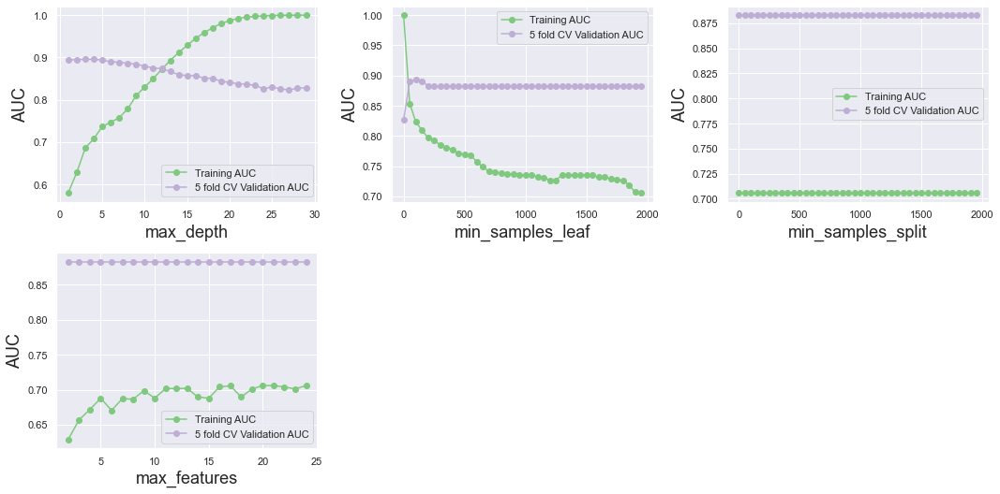

Wall time: 11.3 s


In [104]:
%%time
deTree = DecisionTreeClassifier()
params = {
    'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40],
    'min_samples_leaf': [5, 20, 50, 100, 500],
    'min_samples_split': [5, 20, 50, 100, 500]
}
hypmExplore(deTree, params)

In [105]:
params = {
    'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40],
    'min_samples_split': [5, 20, 50, 100, 500],
    'min_samples_leaf': [5, 20, 50, 100, 500],
    'criterion': ["gini", "entropy"],
    'splitter': ['best','random']    
}
deTree = DecisionTreeClassifier(random_state=42)
grid_search = GridSearchCV(
    estimator=deTree, 
    param_grid=params, 
    cv=5, 
    n_jobs=-1, 
    verbose=1, 
    scoring = "roc_auc")

grid_search.fit(X, y)

Fitting 5 folds for each of 1200 candidates, totalling 6000 fits


GridSearchCV(cv=5, estimator=DecisionTreeClassifier(random_state=42), n_jobs=-1,
             param_grid={'criterion': ['gini', 'entropy'],
                         'max_depth': [2, 3, 4, 5, 6, 7, 8, 9, 10, 20, 30, 40],
                         'min_samples_leaf': [5, 20, 50, 100, 500],
                         'min_samples_split': [5, 20, 50, 100, 500],
                         'splitter': ['best', 'random']},
             scoring='roc_auc', verbose=1)

In [106]:
deTree = grid_search.best_estimator_
deTree

DecisionTreeClassifier(max_depth=20, min_samples_leaf=5, min_samples_split=500,
                       random_state=42)

In [107]:
y_prob = deTree.predict_proba(X_train)[:, 1]
train_AUC = roc_auc_score(y_train, y_prob)
valid_AUC = cross_validate(deTree, X_valid, y_valid, cv=5)['test_score'].mean()
print('train AUC: {}, \nvalidation AUC: {}'.format(train_AUC, valid_AUC))

train AUC: 0.8288434751117939, 
validation AUC: 0.8926520480532639


### Bagging

[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   2 out of  10 | elapsed:    0.2s remaining:    1.1s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    0.3s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   2 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    0.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   2 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    0.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parallel(n_jobs=10)]: Done   2 out of  10 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=10)]: Done  10 out of  10 | elapsed:    0.0s finished
[Parallel(n_jobs=10)]: Using backend LokyBackend with 10 concurrent workers.
[Parall

[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.2s remaining:    1.9s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.5s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.1s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.0s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.4s
[Pa

[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    3.4s remaining:   24.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    3.5s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.3s remaining:    2.4s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.7s remaining:    5.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.7s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.7s remaining:    5.4s
[Pa

[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.7s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.5s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.2s remaining:    2.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.1s remaining:    1.4s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.2s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.1s remaining:    1.2s
[Pa

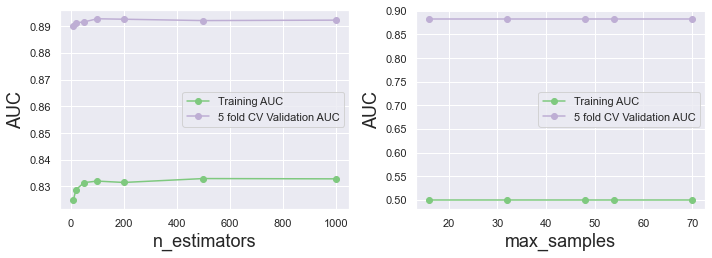

In [108]:
bag = BaggingClassifier(
    deTree,
    random_state=42,
    bootstrap_features=True,
    n_jobs = -1,
    verbose = True)

params = {
    'n_estimators': [10, 20, 50, 100, 200, 500, 1000],
    'max_samples': [16, 32, 48, 54, 70]
}

hypmExplore(bag, params)

In [109]:
params = {
    'n_estimators': [500]
}
grid_search = GridSearchCV(
    estimator = bag, 
    param_grid = params, 
    cv = 5, 
    n_jobs = -1, 
    verbose = 1, 
    scoring = "roc_auc")

grid_search.fit(X, y)

Fitting 5 folds for each of 1 candidates, totalling 5 fits


[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished


GridSearchCV(cv=5,
             estimator=BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=20,
                                                                               min_samples_leaf=5,
                                                                               min_samples_split=500,
                                                                               random_state=42),
                                         bootstrap_features=True,
                                         max_samples=70, n_estimators=1000,
                                         n_jobs=-1, random_state=42,
                                         verbose=True),
             n_jobs=-1, param_grid={'n_estimators': [500]}, scoring='roc_auc',
             verbose=1)

In [110]:
bag = grid_search.best_estimator_
bag

BaggingClassifier(base_estimator=DecisionTreeClassifier(max_depth=20,
                                                        min_samples_leaf=5,
                                                        min_samples_split=500,
                                                        random_state=42),
                  bootstrap_features=True, max_samples=70, n_estimators=500,
                  n_jobs=-1, random_state=42, verbose=True)

In [111]:
y_prob = bag.predict_proba(X_train)[:, 1]
train_AUC = roc_auc_score(y_train, y_prob)
valid_AUC = cross_validate(bag, X_valid, y_valid, cv=5)['test_score'].mean()
print('train AUC: {}, \nvalidation AUC: {}'.format(train_AUC, valid_AUC))

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.1s remaining:    1.6s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.3s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.6s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.6s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parall

train AUC: 0.5, 
validation AUC: 0.8829535388623535


[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.5s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished


### SVM

In [112]:
# sv = svm.SVC(C=2, kernel='rbf', gamma=10, decision_function_shape='ovo', probability=True)
# sv.fit(X_train, y_train)

### Gaussian NB

In [113]:
nb = GaussianNB()
nb.fit(X_train, y_train)

GaussianNB()

### -- Model Performance Summary

In [114]:
models = []
models.append({'name': 'logitCV', 'model': logit})
models.append({'name': 'KNN', 'model': knn})
models.append({'name': 'LGBM','model': lgb})
models.append({'name': 'Random Forest', 'model': rf})
models.append({'name': 'calibrated RF', 'model': calibrated_rf})
models.append({'name': 'Decision Tree', 'model': deTree})
models.append({'name': 'Bagging', 'model': bag})
# models.append({'name' : 'svm', 'model' : svm.SVC(C=2, kernel='rbf', gamma=10, decision_function_shape='ovo', probability=True)})
models.append({'name': 'NB', 'model': nb})


In [115]:
results = []
names = []
seed = 42
msgs = []
thread_list = []

def trainModelThread(model):
    global count
    kfold = KFold(n_splits=10, random_state=seed, shuffle=True)
#     model['model'].fit(X_train, y_train)
    score = cross_val_score(model['model'], X_train, y_train, cv=kfold, scoring='roc_auc')    
    results.append(score)
    name = model['name']
    names.append(name)
    msgs.append("{model} -> mean:{mean}, std:{std}\n".format(model=name, mean=score.mean(), std=score.std()))
    print('{} finished.'.format(name))
    
for model in models:
    thread = threading.Thread(target=trainModelThread, args=(model,))
    thread_list.append(thread)
    thread.start()
    
for thread in thread_list:
    thread.join()

for msg in msgs:
    print(msg)

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.5s remaining:    4.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    1.1s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.7s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.


NB finished.


[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.2s remaining:    2.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.5s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.6s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.1s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.8s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.1s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.5s
[Pa

Decision Tree finished.


[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.5s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.4s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.6s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.5s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.5s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.6s
[Pa

KNN finished.


[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.6s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.4s remaining:    3.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.4s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.5s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.2s remaining:    1.8s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.5s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.5s
[Pa

Bagging finished.
LGBM finished.
logitCV finished.
Random Forest finished.
calibrated RF finished.
NB -> mean:0.7201587802443736, std:0.017128756417455863

Decision Tree -> mean:0.7575914396237204, std:0.016347744061836245

KNN -> mean:0.6971534204150375, std:0.01560218840635423

Bagging -> mean:0.5, std:0.0

LGBM -> mean:0.8002157931918346, std:0.01178636734227817

logitCV -> mean:0.7526988293909088, std:0.01711619539888797

Random Forest -> mean:0.7933420964948008, std:0.014145853195999574

calibrated RF -> mean:0.7939519141275119, std:0.013382770666343195



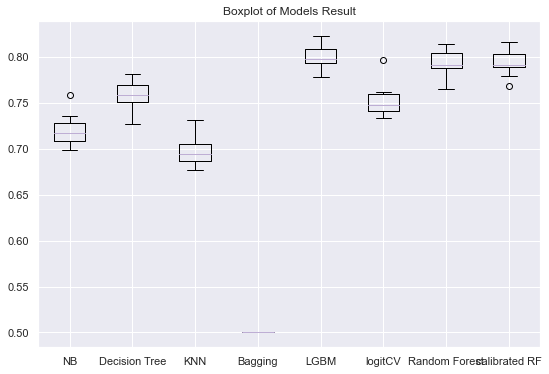

In [116]:
plt.boxplot(results)
index = list(range(1, len(models) + 1))
plt.xticks(index, names)
plt.title('Boxplot of Models Result')
plt.show()

## Model Validation

In [117]:
def getResult(X, y):
    columns = ['Error Rate', 'Sensitivity', 'Specificity', 'Precision', 'AUC', 'Cross-entropy']
    rows = []
    for model in models:
        rows.append(model['name'])
    results = pd.DataFrame(0.0, columns=columns, index=rows) 
    y_prob = np.zeros((len(y), len(models)))

    for i, model in enumerate(models):
        y_prob[:, i] = model['model'].predict_proba(X)[:, 1]
        y_pred = model['model'].predict(X)

        tn, fp, fn, tp = confusion_matrix(y, y_pred).ravel() 

        results.iloc[i,0] = 1 - accuracy_score(y, y_pred)
        results.iloc[i,1] = tp / (tp + fn)
        results.iloc[i,2] = tn / (tn + fp)
        results.iloc[i,3] = precision_score(y, y_pred)
        results.iloc[i,4] = roc_auc_score(y, y_prob[:,i])
        results.iloc[i,5] = log_loss(y, y_prob[:,i])

    table = results.round(3)
    print(table)
    fig, ax = plt.subplots(figsize=(9,6))

    for i in range(y_prob.shape[1]):
        fpr, tpr, thersholds = roc_curve(y, y_prob[:, i])
        auc = roc_auc_score(y, y_prob[:, i])
        ax.plot(1 - fpr, tpr, label=rows[i] + ' (AUC = {:.3f})'.format(auc))

    ax.plot([0,1],[1,0], linestyle='--', color='black', alpha=0.6)

    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.title('ROC Curve')
    plt.legend(loc="lower right")
    plt.show()

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    1.2s remaining:    8.7s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    1.3s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished


               Error Rate  Sensitivity  Specificity  Precision    AUC  \
logitCV             0.106        0.160        0.991      0.696  0.760   
KNN                 0.109        0.131        0.991      0.667  0.857   
LGBM                0.089        0.334        0.987      0.780  0.854   
Random Forest       0.104        0.196        0.988      0.689  0.800   
calibrated RF       0.105        0.190        0.989      0.693  0.801   
Decision Tree       0.103        0.209        0.988      0.706  0.833   
Bagging             0.117        0.000        1.000      0.000  0.500   
NB                  0.193        0.446        0.855      0.290  0.727   

               Cross-entropy  
logitCV                0.304  
KNN                    0.257  
LGBM                   0.253  
Random Forest          0.283  
calibrated RF          0.281  
Decision Tree          0.270  
Bagging                0.361  
NB                     1.404  


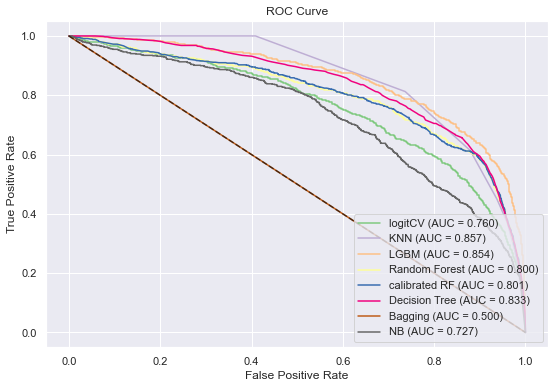

In [118]:
getResult(X_valid, y_valid)

## Model Test

In [119]:
def fitThread(model):
    model.fit(X_train_full, y_train_full)

thread_list = []
for model in models:
    thread = threading.Thread(target=fitThread, args=(model['model'], ))
    thread.start()
    thread_list.append(thread)

for thread in thread_list:
    thread.join()

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.5s remaining:    4.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    1.0s finished


[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished


               Error Rate  Sensitivity  Specificity  Precision    AUC  \
logitCV             0.107        0.173        0.989      0.669  0.743   
KNN                 0.117        0.100        0.987      0.507  0.702   
LGBM                0.105        0.266        0.978      0.620  0.790   
Random Forest       0.105        0.221        0.985      0.658  0.789   
calibrated RF       0.106        0.218        0.984      0.641  0.788   
Decision Tree       0.108        0.240        0.978      0.596  0.766   
Bagging             0.117        0.000        1.000      0.000  0.500   
NB                  0.199        0.417        0.851      0.271  0.707   

               Cross-entropy  
logitCV                0.311  
KNN                    1.031  
LGBM                   0.287  
Random Forest          0.290  
calibrated RF          0.289  
Decision Tree          0.316  
Bagging                0.361  
NB                     1.560  


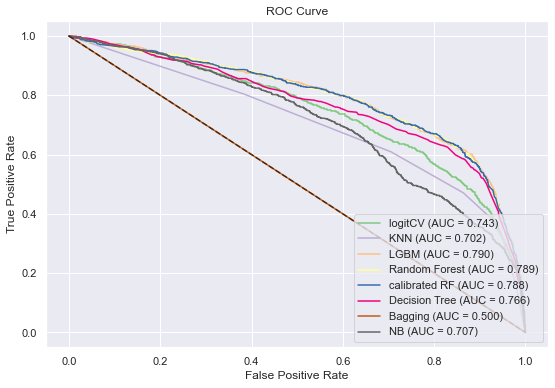

In [120]:
getResult(X_test, y_test)

## Full Train Performance

In [121]:
def fitThread(model):
    model.fit(X, y)

thread_list = []
for model in models:
    thread = threading.Thread(target=fitThread, args=(model['model'], ))
    thread.start()
    thread_list.append(thread)

for thread in thread_list:
    thread.join()

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.5s remaining:    3.9s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    1.1s finished


[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.2s remaining:    2.0s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.3s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.2s remaining:    2.3s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.3s finished


               Error Rate  Sensitivity  Specificity  Precision    AUC  \
logitCV             0.108        0.162        0.989      0.659  0.755   
KNN                 0.110        0.135        0.990      0.652  0.850   
LGBM                0.094        0.303        0.986      0.744  0.855   
Random Forest       0.097        0.256        0.989      0.759  0.917   
calibrated RF       0.097        0.253        0.989      0.750  0.906   
Decision Tree       0.106        0.196        0.986      0.657  0.829   
Bagging             0.117        0.000        1.000      0.000  0.500   
NB                  0.195        0.424        0.856      0.280  0.720   

               Cross-entropy  
logitCV                0.308  
KNN                    0.261  
LGBM                   0.258  
Random Forest          0.237  
calibrated RF          0.247  
Decision Tree          0.275  
Bagging                0.361  
NB                     1.489  


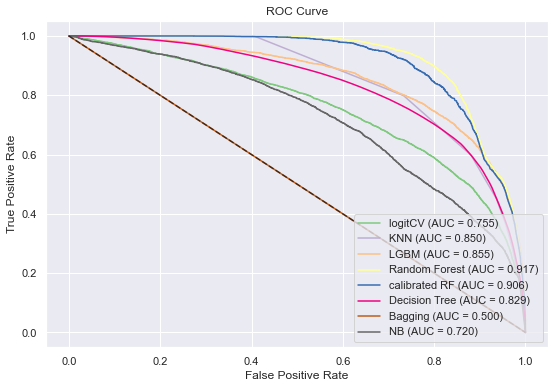

In [122]:
getResult(X, y)

[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.1s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.2s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.0s finished


               Error Rate  Sensitivity  Specificity  Precision    AUC  \
logitCV             0.107        0.172        0.989      0.674  0.746   
KNN                 0.109        0.151        0.989      0.642  0.848   
LGBM                0.094        0.307        0.986      0.740  0.849   
Random Forest       0.096        0.251        0.991      0.779  0.916   
calibrated RF       0.097        0.251        0.990      0.765  0.904   
Decision Tree       0.106        0.192        0.987      0.670  0.824   
Bagging             0.117        0.000        1.000      0.000  0.500   
NB                  0.199        0.416        0.853      0.272  0.708   

               Cross-entropy  
logitCV                0.310  
KNN                    0.262  
LGBM                   0.260  
Random Forest          0.238  
calibrated RF          0.248  
Decision Tree          0.278  
Bagging                0.361  
NB                     1.528  


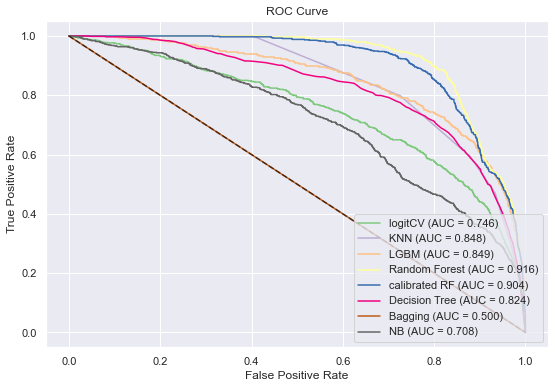

In [123]:
getResult(X_test, y_test)

# Extra test (Delete when update)

In [124]:
data_full = pd.read_excel('Data/bank-full.xlsx')
test_full = pd.merge(test_raw, data_full, on=['age', 'job', 'marital', 'education', 'default', 'balance', 'housing', 'loan', 'day', 'month', 'campaign', 'pdays', 'previous', 'poutcome', 'contact'])
test_full['y'] = test_full['y'].apply(lambda x : 0 if x == 'no' else 1)
test_full['pdays'] = test_full['pdays'].replace({-1: 999})
test_full

,id,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome,y
0,0,43,blue-collar,married,primary,no,517,yes,no,cellular,20,apr,2,263,7,failure,0
1,1,53,unemployed,divorced,secondary,no,587,no,no,cellular,19,nov,1,999,0,unknown,1
2,2,28,blue-collar,single,primary,no,722,yes,no,unknown,21,may,1,999,0,unknown,0
3,3,47,blue-collar,married,secondary,no,2548,yes,no,cellular,11,may,1,368,1,other,0
4,4,37,blue-collar,married,secondary,no,1403,no,no,unknown,9,oct,1,999,0,unknown,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15833,15819,50,technician,married,secondary,no,315,no,no,cellular,8,aug,10,999,0,unknown,0
15834,15820,31,technician,married,secondary,no,30,no,no,telephone,11,aug,5,999,0,unknown,0
15835,15821,47,technician,married,secondary,no,11,no,no,cellular,21,aug,3,999,0,unknown,0
15836,15822,60,retired,divorced,secondary,no,1382,no,no,cellular,30,jul,10,999,0,unknown,0


In [125]:
test_full['month'] = test_full['month'].apply(monthFormat)
test_full['date'] = test_full.apply(dateFormat, axis=1)
start_date = test_full.sort_values('date').iloc[0, :]['date']
test_full['date_diff'] = test_full['date'] - start_date
test_full['date_diff'] = test_full['date_diff'].astype('str').apply(lambda x:x[:-5]).astype('int32')

yj = PowerTransformer(method='yeo-johnson')
test_full['age']  = yj.fit_transform(test_full[['age']])
test_full['balance']  = yj.fit_transform(test_full[['balance']])
test_full['date_diff']  = yj.fit_transform(test_full[['date_diff']])

test_full['age_group'] = setAgeGroup(test_full)
test_full['balance_group'] = setBalanceGroup(test_full)
test_full['pdays_group'] = setPdaysGroup(test_full)
test_full['campaign_group'] = setCampaignGroup(test_full)
test_full['previous_group'] = setPreviousGroup(test_full)
test_full['month_group'] = setMonthGroup(test_full)
# test_full[group_var] = test_full[group_var].astype(str)
for item in group_var:
    test_full[item] = LabelEncoder().fit_transform(test_full[item])
    
test_full[num_var] = scaler.transform(test_full[num_var])
test_full[np.append(cat_var, group_var)] = encoder.transform(test_full[np.append(cat_var, group_var)])


X_test_full = test_full[input_list]
X_test_full = modelTrans.xTrans(X_test_full)
y_test_full = test_full['y']
X_test_full.head()

,age,balance,month,day,pdays,previous,campaign,date_diff,job,education,...,poutcome,age_group,balance_group,campaign_group,pdays_group,previous_group,month_group,age2,month2,date_diff2
0,0.334984,-0.186996,-0.889361,0.496847,-1.961577,3.382627,-0.251246,-0.790696,0.071120,0.086856,...,0.122441,0,0,0,1,1,1,0.112214,0.790962,0.625201
1,1.135795,-0.158082,2.024451,0.376777,0.465589,-0.305997,-0.568197,1.889218,0.151872,0.105145,...,0.092805,0,0,0,1,3,3,1.290029,4.098402,3.569145
2,-1.387063,-0.103805,-0.473102,0.616916,0.465589,-0.305997,-0.568197,-0.355996,0.071120,0.086856,...,0.092805,1,0,0,1,3,1,1.923944,0.223825,0.126733
3,0.678752,0.537018,-0.473102,-0.583781,-1.615310,0.220949,-0.568197,-0.493656,0.071120,0.105145,...,0.169490,0,1,0,1,0,1,0.460704,0.223825,0.243696
4,-0.256251,0.150329,1.608192,-0.823920,0.465589,-0.305997,-0.568197,1.415037,0.071120,0.105145,...,0.092805,1,1,0,1,3,3,0.065664,2.586282,2.002330


[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.9s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.2s finished
[Parallel(n_jobs=16)]: Using backend LokyBackend with 16 concurrent workers.
[Parallel(n_jobs=16)]: Done   2 out of  16 | elapsed:    0.0s remaining:    0.8s
[Parallel(n_jobs=16)]: Done  16 out of  16 | elapsed:    0.1s finished


               Error Rate  Sensitivity  Specificity  Precision    AUC  \
logitCV             0.106        0.157        0.992      0.711  0.766   
KNN                 0.117        0.098        0.987      0.503  0.714   
LGBM                0.103        0.257        0.981      0.647  0.802   
Random Forest       0.104        0.216        0.986      0.667  0.796   
calibrated RF       0.104        0.221        0.985      0.662  0.797   
Decision Tree       0.108        0.194        0.984      0.623  0.774   
Bagging             0.117        0.000        1.000      0.000  0.500   
NB                  0.178        0.421        0.875      0.308  0.731   

               Cross-entropy  
logitCV                0.304  
KNN                    1.135  
LGBM                   0.284  
Random Forest          0.289  
calibrated RF          0.288  
Decision Tree          0.355  
Bagging                0.361  
NB                     1.435  


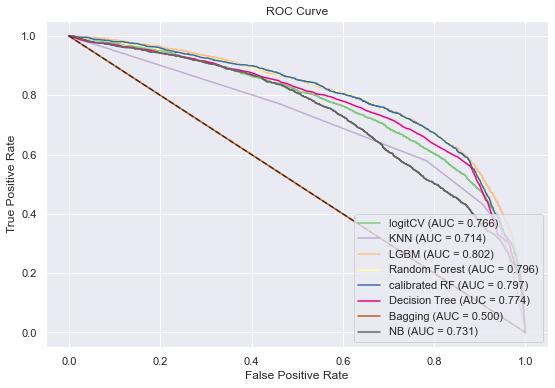

In [126]:
getResult(X_test_full, y_test_full)

## Final Export (True test)

In [127]:
test = test_raw.copy()
test.head()

,id,age,job,marital,education,default,balance,housing,loan,contact,day,month,campaign,pdays,previous,poutcome
0,0,43,blue-collar,married,primary,no,517,yes,no,cellular,20,apr,2,263,7,failure
1,1,53,unemployed,divorced,secondary,no,587,no,no,cellular,19,nov,1,-1,0,unknown
2,2,28,blue-collar,single,primary,no,722,yes,no,unknown,21,may,1,-1,0,unknown
3,3,47,blue-collar,married,secondary,no,2548,yes,no,cellular,11,may,1,368,1,other
4,4,37,blue-collar,married,secondary,no,1403,no,no,unknown,9,oct,1,-1,0,unknown


In [128]:
test['month'] = test['month'].apply(monthFormat)
test['date'] = test.apply(dateFormat, axis=1)
start_date = test.sort_values('date').iloc[0, :]['date']
test['date_diff'] = test['date'] - start_date
test['date_diff'] = test['date_diff'].astype('str').apply(lambda x:x[:-5]).astype('int32')

yj = PowerTransformer(method='yeo-johnson')
test['age']  = yj.fit_transform(test[['age']])
test['balance']  = yj.fit_transform(test[['balance']])
test['date_diff']  = yj.fit_transform(test[['date_diff']])

test['age_group'] = setAgeGroup(test)
test['balance_group'] = setBalanceGroup(test)
test['pdays_group'] = setPdaysGroup(test)
test['campaign_group'] = setCampaignGroup(test)
test['previous_group'] = setPreviousGroup(test)
test['month_group'] = setMonthGroup(test)
# test[group_var] = test[group_var].astype(str)
for item in group_var:
    test[item] = LabelEncoder().fit_transform(test[item])

test[num_var] = scaler.transform(test[num_var])
test[np.append(cat_var, group_var)] = encoder.transform(test[np.append(cat_var, group_var)])

X_test = test[input_list]
X_test = modelTrans.xTrans(X_test)
X_test.head()

,age,balance,month,day,pdays,previous,campaign,date_diff,job,education,...,poutcome,age_group,balance_group,campaign_group,pdays_group,previous_group,month_group,age2,month2,date_diff2
0,0.334338,-0.187431,-0.889361,0.496847,-1.961577,3.382627,-0.251246,-0.789796,0.071120,0.086856,...,0.122441,0,0,0,1,1,1,0.111782,0.790962,0.623777
1,1.135236,-0.158524,2.024451,0.376777,-2.832190,-0.305997,-0.568197,1.889010,0.151872,0.105145,...,0.092805,0,0,0,2,3,3,1.288760,4.098402,3.568360
2,-1.387074,-0.104261,-0.473102,0.616916,-2.832190,-0.305997,-0.568197,-0.355114,0.071120,0.086856,...,0.092805,1,0,0,2,3,1,1.923973,0.223825,0.126106
3,0.678112,0.536434,-0.473102,-0.583781,-1.615310,0.220949,-0.568197,-0.492760,0.071120,0.105145,...,0.169490,0,1,0,1,0,1,0.459836,0.223825,0.242812
4,-0.256803,0.149816,1.608192,-0.823920,-2.832190,-0.305997,-0.568197,1.415168,0.071120,0.105145,...,0.092805,1,1,0,2,3,3,0.065948,2.586282,2.002701


In [129]:
# Probability
method = lgb
test_prob = method.predict_proba(X_test)[:, 1]
y_pred = method.predict(X_test)

pd.DataFrame(test_prob)

,0
0,0.036435
1,0.078350
2,0.072533
3,0.048459
4,0.119925
...,...
15819,0.103337
15820,0.067703
15821,0.091142
15822,0.106968


In [130]:
y_prob_final = test_prob
test_pred = test.copy()
test_pred['subscribed'] = y_prob_final
test_pred

,id,age,job,marital,education,default,balance,housing,loan,contact,...,poutcome,date,date_diff,age_group,balance_group,pdays_group,campaign_group,previous_group,month_group,subscribed
0,0,0.334338,0.071120,0.102425,0.086856,0.117881,-0.187431,0.077685,0.125992,0.148487,...,0.122441,2021-04-20,-0.789796,0,0,1,0,1,1,0.036435
1,1,1.135236,0.151872,0.120794,0.105145,0.117881,-0.158524,0.165924,0.125992,0.148487,...,0.092805,2021-11-19,1.889010,0,0,2,0,3,3,0.078350
2,2,-1.387074,0.071120,0.145934,0.086856,0.117881,-0.104261,0.077685,0.125992,0.041735,...,0.092805,2021-05-21,-0.355114,1,0,2,0,3,1,0.072533
3,3,0.678112,0.071120,0.102425,0.105145,0.117881,0.536434,0.077685,0.125992,0.148487,...,0.169490,2021-05-11,-0.492760,0,1,1,0,0,1,0.048459
4,4,-0.256803,0.071120,0.102425,0.105145,0.117881,0.149816,0.165924,0.125992,0.041735,...,0.092805,2021-10-09,1.415168,1,1,2,0,3,3,0.119925
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15819,15819,0.914572,0.108623,0.102425,0.105145,0.117881,-0.274853,0.165924,0.125992,0.148487,...,0.092805,2021-08-08,0.668664,0,0,2,0,3,2,0.103337
15820,15820,-0.969250,0.108623,0.102425,0.105145,0.117881,-0.420577,0.165924,0.125992,0.131252,...,0.092805,2021-08-11,0.705756,1,0,2,0,3,2,0.067703
15821,15821,0.678112,0.108623,0.102425,0.105145,0.117881,-0.433854,0.165924,0.125992,0.148487,...,0.092805,2021-08-21,0.828623,0,0,2,0,3,2,0.091142
15822,15822,1.598521,0.231933,0.120794,0.105145,0.117881,0.142338,0.165924,0.125992,0.148487,...,0.092805,2021-07-30,0.556716,0,1,2,0,3,2,0.106968


### Export

In [131]:
submission = test_pred[['id', 'subscribed']]
submission.to_csv("submission.csv", index = False)
submission

,id,subscribed
0,0,0.036435
1,1,0.078350
2,2,0.072533
3,3,0.048459
4,4,0.119925
...,...,...
15819,15819,0.103337
15820,15820,0.067703
15821,15821,0.091142
15822,15822,0.106968
